# Úvod

![meme](https://i.pinimg.com/474x/4a/40/ba/4a40ba8df294a3566edf8f0e3013ed68.jpg)

**Rotten Tomatoes** je jedním z nejlepších zdrojů pro recenze filmových kritiků. Tento dataset obsahuje informace o filmech, jejich žánrech, hodnoceních uživatelů (*audience score*) a kritiků (*tomatometer*). Data byla získána scrapingem z veřejně dostupné webové stránky [Rotten Tomatoes](https://www.rottentomatoes.com) k datu **31. 10. 2020**. Cílem analýzy je porovnat recenze kritiků s hodnoceními uživatelů a odhalit případné rozdíly.

[Odkaz](https://www.kaggle.com/datasets/stefanoleone992/rotten-tomatoes-movies-and-critic-reviews-dataset/data) na Kaggle dataset.


# Načtení knihoven

In [390]:
import random
from pathlib import Path
import os
from collections import Counter
import re
import time
import pickle

import kagglehub
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from wordcloud import WordCloud

import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer

from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

import optuna
from optuna.samplers import TPESampler
from optuna.visualization import (
    plot_optimization_history, plot_parallel_coordinate, 
    plot_param_importances, plot_contour, plot_slice,
    plot_edf, plot_timeline, plot_rank
)

from transformers import TFDistilBertForSequenceClassification, DistilBertTokenizer
from transformers import create_optimizer

import tensorflow as tf
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.layers import Input, Embedding, LSTM, TextVectorization, Flatten, Dense, Dropout, Bidirectional, Conv1D, GlobalMaxPooling1D, Concatenate, GlobalAveragePooling1D, BatchNormalization, RepeatVector, Activation, Permute, Multiply, Lambda
from tensorflow.keras.initializers import Constant
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import ModelCheckpoint, TensorBoard, EarlyStopping
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import load_model

## NTLK data

In [2]:
try:
	nltk.data.find('corpora/stopwords')
	nltk.data.find('corpora/wordnet')
except LookupError:
	nltk.download('stopwords', quiet=True)
	nltk.download('wordnet', quiet=True)

# Nastavení stejného náhodného prostředí

In [3]:
SEED = 42

random.seed(SEED)
np.random.seed(SEED)
os.environ['PYTHONHASHSEED'] = str(SEED)
tf.config.experimental.enable_op_determinism()
os.environ['TF_DETERMINISTIC_OPS'] = '1'
tf.random.set_seed(SEED)

# Načtení dat

In [4]:
path = kagglehub.dataset_download("stefanoleone992/rotten-tomatoes-movies-and-critic-reviews-dataset")

In [5]:
%ls ~/.cache/kagglehub/datasets/stefanoleone992/rotten-tomatoes-movies-and-critic-reviews-dataset/versions/1

rotten_tomatoes_critic_reviews.csv  rotten_tomatoes_movies.csv


In [6]:
file_path = Path(path) / "rotten_tomatoes_critic_reviews.csv"
df = pd.read_csv(file_path)
df.head()

,rotten_tomatoes_link,critic_name,top_critic,publisher_name,review_type,review_score,review_date,review_content
0,m/0814255,Andrew L. Urban,False,Urban Cinefile,Fresh,NaN,2010-02-06,A fantasy adventure that fuses Greek mythology...
1,m/0814255,Louise Keller,False,Urban Cinefile,Fresh,NaN,2010-02-06,"Uma Thurman as Medusa, the gorgon with a coiff..."
2,m/0814255,NaN,False,FILMINK (Australia),Fresh,NaN,2010-02-09,With a top-notch cast and dazzling special eff...
3,m/0814255,Ben McEachen,False,Sunday Mail (Australia),Fresh,3.5/5,2010-02-09,Whether audiences will get behind The Lightnin...
4,m/0814255,Ethan Alter,True,Hollywood Reporter,Rotten,NaN,2010-02-10,What's really lacking in The Lightning Thief i...


In [7]:
movies_path = Path(path) / "rotten_tomatoes_movies.csv"
df_movies = pd.read_csv(movies_path)
df_movies.head()

,rotten_tomatoes_link,movie_title,movie_info,critics_consensus,content_rating,genres,directors,authors,actors,original_release_date,...,production_company,tomatometer_status,tomatometer_rating,tomatometer_count,audience_status,audience_rating,audience_count,tomatometer_top_critics_count,tomatometer_fresh_critics_count,tomatometer_rotten_critics_count
0,m/0814255,Percy Jackson & the Olympians: The Lightning T...,"Always trouble-prone, the life of teenager Per...",Though it may seem like just another Harry Pot...,PG,"Action & Adventure, Comedy, Drama, Science Fic...",Chris Columbus,"Craig Titley, Chris Columbus, Rick Riordan","Logan Lerman, Brandon T. Jackson, Alexandra Da...",2010-02-12,...,20th Century Fox,Rotten,49.0,149.0,Spilled,53.0,254421.0,43,73,76
1,m/0878835,Please Give,Kate (Catherine Keener) and her husband Alex (...,Nicole Holofcener's newest might seem slight i...,R,Comedy,Nicole Holofcener,Nicole Holofcener,"Catherine Keener, Amanda Peet, Oliver Platt, R...",2010-04-30,...,Sony Pictures Classics,Certified-Fresh,87.0,142.0,Upright,64.0,11574.0,44,123,19
2,m/10,10,"A successful, middle-aged Hollywood songwriter...",Blake Edwards' bawdy comedy may not score a pe...,R,"Comedy, Romance",Blake Edwards,Blake Edwards,"Dudley Moore, Bo Derek, Julie Andrews, Robert ...",1979-10-05,...,Waner Bros.,Fresh,67.0,24.0,Spilled,53.0,14684.0,2,16,8
3,m/1000013-12_angry_men,12 Angry Men (Twelve Angry Men),Following the closing arguments in a murder tr...,Sidney Lumet's feature debut is a superbly wri...,NR,"Classics, Drama",Sidney Lumet,Reginald Rose,"Martin Balsam, John Fiedler, Lee J. Cobb, E.G....",1957-04-13,...,Criterion Collection,Certified-Fresh,100.0,54.0,Upright,97.0,105386.0,6,54,0
4,m/1000079-20000_leagues_under_the_sea,"20,000 Leagues Under The Sea","In 1866, Professor Pierre M. Aronnax (Paul Luk...","One of Disney's finest live-action adventures,...",G,"Action & Adventure, Drama, Kids & Family",Richard Fleischer,Earl Felton,"James Mason, Kirk Douglas, Paul Lukas, Peter L...",1954-01-01,...,Disney,Fresh,89.0,27.0,Upright,74.0,68918.0,5,24,3


Spolu s recenzemi byly načteny i názvy filmů a jejich žánry. Protože se zaměřujeme na klasifikaci, tento soubor s informacemi o filmech nebudeme dále využívat, protože zde klasifikace není možná a pro recenze jej nemůžeme použít. 

# EDA

Cílem anlýzy je vlastně přijít na to, který atribut vybereme pro klasifikaci, jelikož jich tu máme více. To a samozřejmě i ostatní informace a vizualizace.

## Základní statistiky

In [8]:
df.head()

,rotten_tomatoes_link,critic_name,top_critic,publisher_name,review_type,review_score,review_date,review_content
0,m/0814255,Andrew L. Urban,False,Urban Cinefile,Fresh,NaN,2010-02-06,A fantasy adventure that fuses Greek mythology...
1,m/0814255,Louise Keller,False,Urban Cinefile,Fresh,NaN,2010-02-06,"Uma Thurman as Medusa, the gorgon with a coiff..."
2,m/0814255,NaN,False,FILMINK (Australia),Fresh,NaN,2010-02-09,With a top-notch cast and dazzling special eff...
3,m/0814255,Ben McEachen,False,Sunday Mail (Australia),Fresh,3.5/5,2010-02-09,Whether audiences will get behind The Lightnin...
4,m/0814255,Ethan Alter,True,Hollywood Reporter,Rotten,NaN,2010-02-10,What's really lacking in The Lightning Thief i...


Vidíme, že `rotten_tomatoes_link` obsahuje odkazy na recenze, které nám během dalšího počínání nějak nepomohou. Proto sloupec můžeme rovnou vypustit.

In [9]:
df = df.drop(columns=["rotten_tomatoes_link"])
df.head()

,critic_name,top_critic,publisher_name,review_type,review_score,review_date,review_content
0,Andrew L. Urban,False,Urban Cinefile,Fresh,NaN,2010-02-06,A fantasy adventure that fuses Greek mythology...
1,Louise Keller,False,Urban Cinefile,Fresh,NaN,2010-02-06,"Uma Thurman as Medusa, the gorgon with a coiff..."
2,NaN,False,FILMINK (Australia),Fresh,NaN,2010-02-09,With a top-notch cast and dazzling special eff...
3,Ben McEachen,False,Sunday Mail (Australia),Fresh,3.5/5,2010-02-09,Whether audiences will get behind The Lightnin...
4,Ethan Alter,True,Hollywood Reporter,Rotten,NaN,2010-02-10,What's really lacking in The Lightning Thief i...


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1130017 entries, 0 to 1130016
Data columns (total 7 columns):
 #   Column          Non-Null Count    Dtype 
---  ------          --------------    ----- 
 0   critic_name     1111488 non-null  object
 1   top_critic      1130017 non-null  bool  
 2   publisher_name  1130017 non-null  object
 3   review_type     1130017 non-null  object
 4   review_score    824081 non-null   object
 5   review_date     1130017 non-null  object
 6   review_content  1064211 non-null  object
dtypes: bool(1), object(6)
memory usage: 52.8+ MB


In [11]:
df.shape

(1130017, 7)

Páni, máme zde **1 130 017** instancí a _8_ sloupců. 

### Názvy sloupců

In [12]:
print(*df.columns, sep="\n")

critic_name
top_critic
publisher_name
review_type
review_score
review_date
review_content


### Počet chybějících hodnot pro každý sloupec

In [13]:
for col in df.columns:
	print(f"{col}: {df[col].isna().sum()}")

critic_name: 18529
top_critic: 0
publisher_name: 0
review_type: 0
review_score: 305936
review_date: 0
review_content: 65806


Vidíme, že jediné atributy, které obsahují chybějící hodnoty, jsou `critic_name`, `review_score`, `publisher_name` a `review_context`. Všechny ostatní sloupce jsou kompletní.

`critic_name` obsahuje jména jednotlivých autorů recenzí, což pro náš účel není relevantní. Proto jej můžeme vypustit. Stejně tak jako `top_critic` a `review_date`, které neposkytují žádné užitečné informace pro klasifikaci. Mohly bychom si na nich ukázat pár pěkných vizualizací, ale proč si komplikovat život, že?

Chybějící hodnoty v `review_content`, což bude hlavní atribut pro klasifikaci asi nějak přežijeme, jelikož máme **1 130 017** instancí. 

In [14]:
columns_to_drop = ["critic_name", "top_critic", "review_date", "publisher_name"]

## Výběr klíčového atributu

Na výběr máme dvě možnosti:
- `review_score` – číselné hodnocení recenze v rozsahu od 0 do 100.
- `review_type` – kategorizované označení recenze s hodnotami **Fresh** (čerstvá) a **Rotten** (shnilá), reprezentující pozitivní nebo negativní hodnocení.

Obě dvě možnosti jsou vhodné pro klasifikaci. Pojdmě se na ně podívat blíže.

In [15]:
print(f"Unikátní hodnoty v 'review_score': {df['review_score'].count()}")
print(df["review_score"].sample(10, random_state=SEED))
print(f"Počet chybějících hodnot v 'review_score': {df['review_score'].isna().sum()}")

Unikátní hodnoty v 'review_score': 824081
1016770      2/5
515691       4/5
319368       NaN
183078      6/10
640819     2.5/4
601012       3/5
647251      8/10
283290       NaN
847580       NaN
975940       NaN
Name: review_score, dtype: object
Počet chybějících hodnot v 'review_score': 305936


In [16]:
print(f"Unikátní hodnoty v 'review_type': {df['review_type'].unique()}")
print(f"Počet chybějících hodnot v 'review_type': {df['review_type'].isna().sum()}")

Unikátní hodnoty v 'review_type': ['Fresh' 'Rotten']
Počet chybějících hodnot v 'review_type': 0


Vybereme `review_type`, protože `review_score` není unifikované hodnocení, chybějí tam hodnoty a `review_type` je lepší, protože je kompletní a jednotné. U `review_score` máme **824 081** různých hodnot!

Proto se můžeme rovnou zbavit sloupce `review_score`, který nebudeme potřebovat a ani ho nijak nebudeme vyzualizovat, jelikož je nemožné ho sjednotit do jednoho formátu a pomoct si tím při klasifikaci.

![meme](https://media.makeameme.org/created/these-rotten-tomatoes-7e2d470239.jpg)

In [17]:
columns_to_drop.append("review_score")

In [18]:
key_columns = "review_type"

## Atribut pro obsah recenze

### Průměrná délka recenze

In [19]:
df["review_content"].str.len().mean()

np.float64(128.00649495259867)

### Medianí délky recenze

In [20]:
df['review_content'].str.len().median()

np.float64(127.0)

### Maximální délka recenze

In [21]:
df['review_content'].str.len().max()

np.float64(258.0)

### Minimální délka recenze

In [22]:
df['review_content'].str.len().min()

np.float64(1.0)

### Spodní kvartil délky recenze

In [23]:
df['review_content'].str.len().quantile(0.25)

np.float64(86.0)

### Horní kvartil délky recenze

In [24]:
df["review_content"].str.len().quantile(0.75)

np.float64(167.0)

### Ukázka několika recenzí

In [25]:
for i in range(5):
	idx = random.randint(0, len(df) - 1)
	review_text = df['review_content'].iloc[idx]
	review_type = df['review_type'].iloc[idx]
	
	type_color = "\033[92m" if review_type == "Fresh" else "\033[91m"
	
	print(f"\nRecenze {i+1} ({type_color}{review_type}\033[0m):")
	print("-" * 80)
	if pd.isna(review_text):
		print("Text recenze není dostupný")
	else:
		print(review_text[:500] + "..." if len(review_text) > 500 else review_text)
	print("-" * 80)


Recenze 1 (Fresh):
--------------------------------------------------------------------------------
Bizarrely entertaining and brilliantly designed.
--------------------------------------------------------------------------------

Recenze 2 (Fresh):
--------------------------------------------------------------------------------
[Generosity] seems to resonate in Andrew Dickson's sweet, melancholy score, in Dick Pope's tactfully beautiful images and in every frame of this sad, resolute film.
--------------------------------------------------------------------------------

Recenze 3 (Rotten):
--------------------------------------------------------------------------------
Call me picky, but I want my movies about miracles to leave me with wonder in my eyes, along with a tear or two.
--------------------------------------------------------------------------------

Recenze 4 (Fresh):
--------------------------------------------------------------------------------
One of the very best film

## Vizualizace

Zbyly nám jen dva sloupce: `review_type` a `review_content`. Pojdmě se na ně podívat blíže...

### Rozložení recenzí podle typu recenze

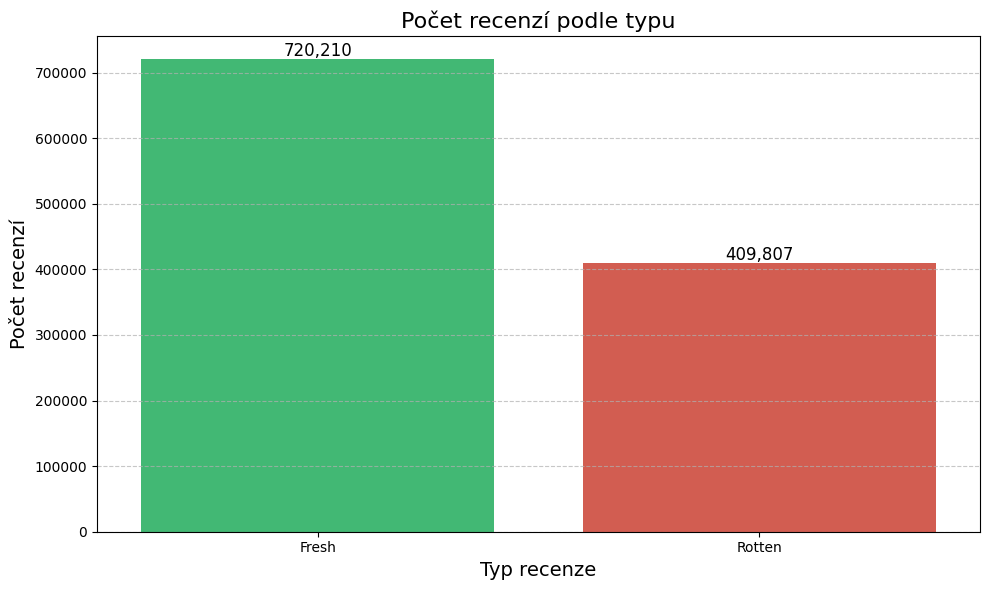

In [26]:
review_type_counts = df[key_columns].value_counts()

custom_palette_colors = ['#2ecc71', '#e74c3c']

plt.figure(figsize=(10, 6))
sns.barplot(x=review_type_counts.index, y=review_type_counts.values, hue=review_type_counts.index, palette=custom_palette_colors, legend=False)

for i, v in enumerate(review_type_counts.values):
	plt.text(i, v + 5000, f"{v:,}", ha='center', fontsize=12)

plt.title("Počet recenzí podle typu", fontsize=16)
plt.xlabel("Typ recenze", fontsize=14)
plt.ylabel("Počet recenzí", fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Vidíme, že máme stále dostatek dat pro obě kategorie recenzí. **Fresh** recezní máme **720 210** a **Rotten** recenzí máme **409 807**. To je více než dostatečné množství pro klasifikaci.

#### Procentuální zastoupení jednotlivých typů recenzí

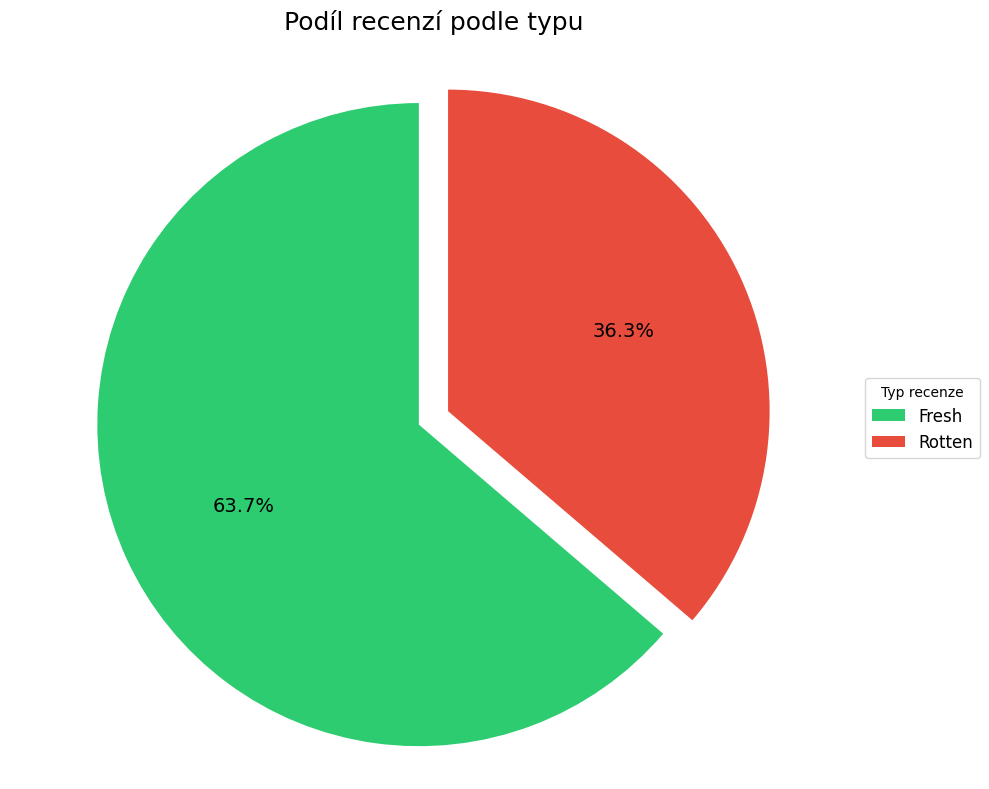

In [27]:
plt.figure(figsize=(10, 8))
explode = (0.05, 0.05) 
wedges, texts, autotexts = plt.pie(
	review_type_counts.values, 
	labels=None,  # Remove default labels
	autopct='%1.1f%%',
	startangle=90, 
	colors=custom_palette_colors,
	explode=explode,
	shadow=False,
	textprops={'fontsize': 14}
)

plt.legend(
	wedges, 
	review_type_counts.index,
	title="Typ recenze",
	loc="center left",
	bbox_to_anchor=(1, 0.5),
	fontsize=12
)

plt.title("Podíl recenzí podle typu", fontsize=18, pad=20)
plt.axis('equal')
plt.tight_layout()
plt.show()


#### Rozložení recenzí podle typu recenze bez chybějících hodnot

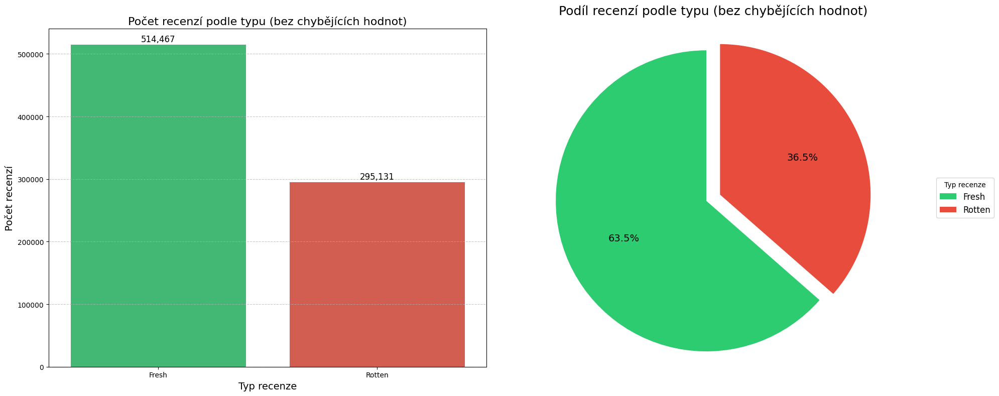

In [28]:
df_no_na = df.dropna(subset=columns_to_drop)
fig, axes = plt.subplots(1, 2, figsize=(20, 8))
review_type_counts_no_na = df_no_na[key_columns].value_counts()
sns.barplot(
	x=review_type_counts_no_na.index, 
	y=review_type_counts_no_na.values, 
	hue=review_type_counts_no_na.index, 
	palette=custom_palette_colors, 
	legend=False, 
	ax=axes[0]
)
for i, v in enumerate(review_type_counts_no_na.values):
	axes[0].text(i, v + 5000, f"{v:,}", ha='center', fontsize=12)
axes[0].set_title("Počet recenzí podle typu (bez chybějících hodnot)", fontsize=16)
axes[0].set_xlabel("Typ recenze", fontsize=14)
axes[0].set_ylabel("Počet recenzí", fontsize=14)
axes[0].grid(axis='y', linestyle='--', alpha=0.7)
wedges, texts, autotexts = axes[1].pie(
	review_type_counts_no_na.values, 
	labels=None,  
	autopct='%1.1f%%',
	startangle=90, 
	colors=custom_palette_colors,
	explode=explode,
	shadow=False,
	textprops={'fontsize': 14}
)
axes[1].legend(
	wedges, 
	review_type_counts_no_na.index,
	title="Typ recenze",
	loc="center left",
	bbox_to_anchor=(1, 0.5),
	fontsize=12
)
axes[1].set_title("Podíl recenzí podle typu (bez chybějících hodnot)", fontsize=18, pad=20)
axes[1].axis('equal')
plt.tight_layout()
plt.show()

In [29]:
comparison_df = pd.DataFrame({
	'Počet recenzí (všechna data)': review_type_counts.values,
	'Počet recenzí (bez chybějících hodnot)': review_type_counts_no_na.values,
	'Rozdíl': review_type_counts - review_type_counts_no_na,
	'Rozdíl (%)': ((review_type_counts - review_type_counts_no_na) / review_type_counts * 100).round(2)
}, index=review_type_counts.index)

total_row = pd.Series({
	'Počet recenzí (všechna data)': review_type_counts.sum(),
	'Počet recenzí (bez chybějících hodnot)': review_type_counts_no_na.sum(),
	'Rozdíl': (review_type_counts - review_type_counts_no_na).sum(),
	'Rozdíl (%)': ((review_type_counts - review_type_counts_no_na).sum() / review_type_counts.sum() * 100).round(2)
}, name='Celkem')

comparison_df = pd.concat([comparison_df, pd.DataFrame([total_row])])

for col in ['Počet recenzí (všechna data)', 'Počet recenzí (bez chybějících hodnot)', 'Rozdíl']:
	comparison_df[col] = comparison_df[col].apply(lambda x: f"{int(x):,}")

comparison_df['Rozdíl (%)'] = comparison_df['Rozdíl (%)'].apply(lambda x: f"{x:.2f}%")

comparison_df

,Počet recenzí (všechna data),Počet recenzí (bez chybějících hodnot),Rozdíl,Rozdíl (%)
Fresh,"720,210","514,467","205,743",28.57%
Rotten,"409,807","295,131","114,676",27.98%
Celkem,"1,130,017","809,598","320,419",28.36%


- U pozitivních recenzí (**Fresh**) jsme z původních **720 210** záznamů zachovali pouze **514 467**, což znamená ztrátu **28,57 %** dat.
- U negativních recenzí (**Rotten**) klesl počet z **409 807** na **295 131**, tedy o **27,98 %**.
- Celkově jsme z původní množiny **1 130 017** recenzí zachovali pouze **809 598**, což představuje ztrátu **28,36 %** všech dat, tedy 320 419 záznamů.

Podobné procentuální úbytky v obou kategoriích naznačují, že chybějící hodnoty jsou rovnoměrně distribuované a neovlivňují významně poměr mezi pozitivními a negativními recenzemi.

### Délka jednotlivých recenzí

#### Distribuce délky recenzí

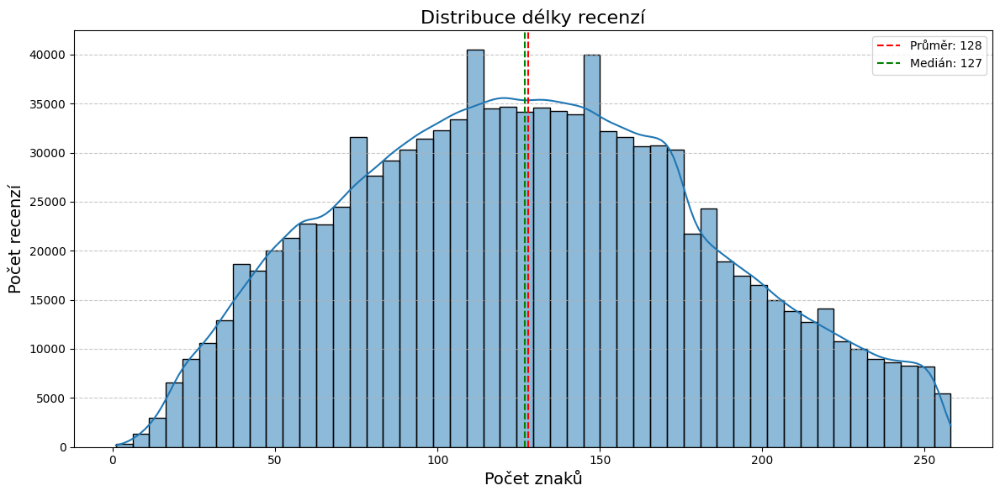

In [30]:
plt.figure(figsize=(12, 6))
sns.histplot(df['review_content'].str.len().dropna(), bins=50, kde=True)
plt.title('Distribuce délky recenzí', fontsize=16)
plt.xlabel('Počet znaků', fontsize=14)
plt.ylabel('Počet recenzí', fontsize=14)
plt.axvline(df['review_content'].str.len().mean(), color='red', linestyle='--', 
		   label=f'Průměr: {df["review_content"].str.len().mean():.0f}')
plt.axvline(df['review_content'].str.len().median(), color='green', linestyle='--', 
		   label=f'Medián: {df["review_content"].str.len().median():.0f}')
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

Vizualizace sedí s statistikami, které jsme si ukázali dříve. Medián délky recenze je **127** a průměrná délka recenze je **127**. Vidíme, že rozložení délky má normální rozdělení s mírným nakloněním doprava.

Pokud se podíváme na distribuci délky krátkých recenzí, třeba do 10 znaků, vidíme, že jich je je celkem hodně.

In [31]:
char_counts = df['review_content'].str.len().value_counts().sort_index()
char_counts = char_counts[char_counts.index <= 10]
char_counts_dict = char_counts.to_dict()
print("Počty recenzí podle počtu znaků (1-10):")
for count, freq in char_counts_dict.items():
	print(f"{count} znaků: {freq} recenzí")


Počty recenzí podle počtu znaků (1-10):
1.0 znaků: 41 recenzí
2.0 znaků: 3 recenzí
3.0 znaků: 22 recenzí
4.0 znaků: 57 recenzí
5.0 znaků: 111 recenzí
6.0 znaků: 118 recenzí
7.0 znaků: 146 recenzí
8.0 znaků: 195 recenzí
9.0 znaků: 271 recenzí
10.0 znaků: 354 recenzí


![meme](https://preview.redd.it/8mcfwv4vv8281.jpg?width=1080&crop=smart&auto=webp&s=6fc749b61201869ec221ea68b7101c897194c794)

Pokud vezmeme v úvahu, že recenze může obsahovat jediné slovo, například „Great“, „Bad“, „Amazing“ atd., můžeme říci, že recenze s délkou do 10 znaků jsou v pořádku. Přesto však odfiltrujeme recenze kratší než 2 znaky, protože ty už jsou opravdu velmi krátké a pravděpodobně neobsahují žádný smysluplný obsah. Jako hranici volím dvě znaky, protože recenze kratší než dva znaky jsou pouze jednoznakové – těch je 41 – a dvouznakové recenze mohou být například „OK“, „No“, „Yes“ atd., což už nějaký smysl dává. Je to malý počet, ale zamyslel jsem se nad tím.

#### Délka recenzí podle typu recenze

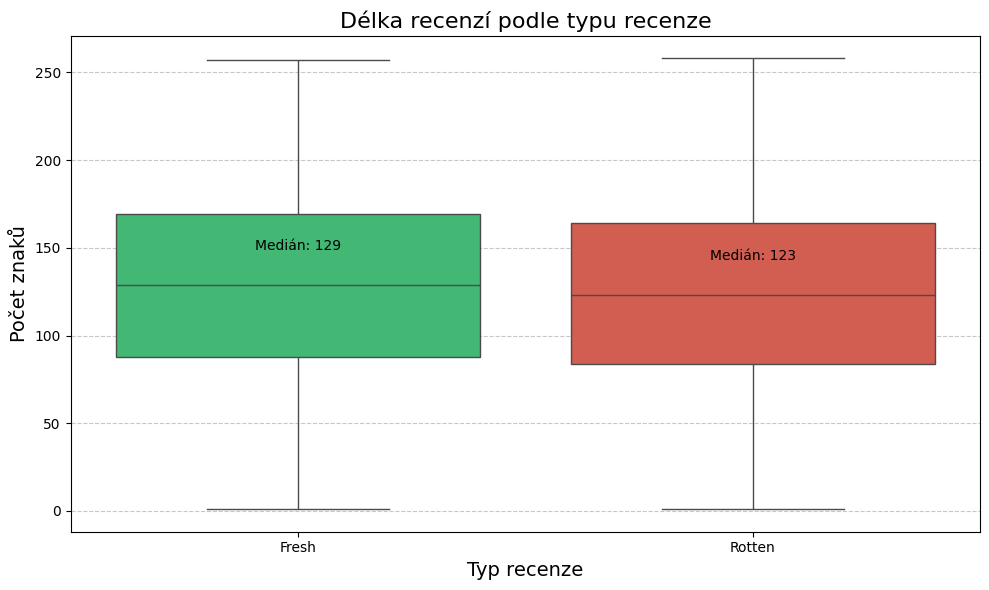

In [32]:
plt.figure(figsize=(10, 6))

temp_data = pd.DataFrame({
	'review_type': df['review_type'],
	'length': df['review_content'].str.len()
})

sns.boxplot(x='review_type', y='length', data=temp_data, hue='review_type', palette=custom_palette_colors, legend=False)
plt.title('Délka recenzí podle typu recenze', fontsize=16)
plt.xlabel('Typ recenze', fontsize=14)
plt.ylabel('Počet znaků', fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)

medians = temp_data.groupby('review_type')['length'].median()
for i, review_type in enumerate(medians.index):
	plt.text(i, medians[review_type] + 20, f'Medián: {medians[review_type]:.0f}', 
			 ha='center', fontsize=10)
plt.tight_layout()
plt.show()

Distribuce jednotlivých tříd je velmi podobná, což je pro nás dobrá zpráva a můžeme použít znalosti získáné z předchozí vizualizace. 

#### Poečet slov v jednotlivých recenzích

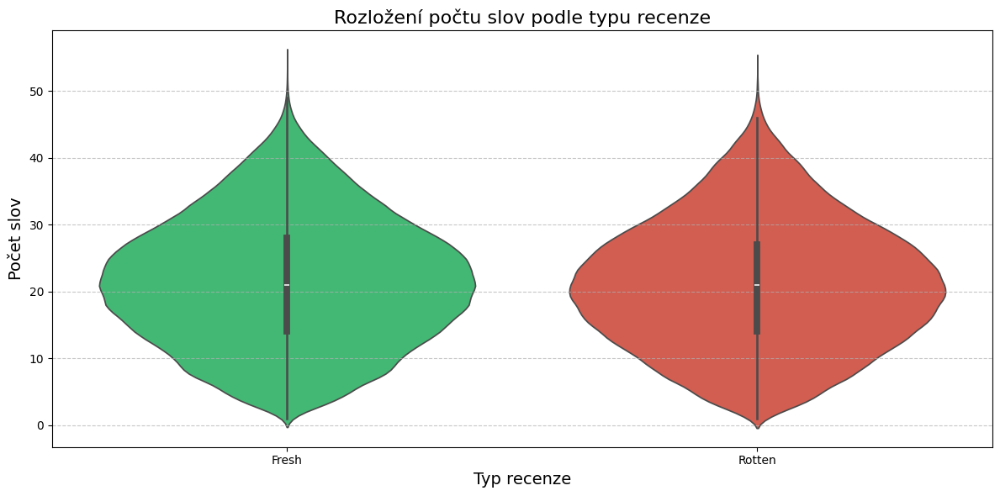

In [33]:
temp_data['word_count'] = df['review_content'].str.split().str.len()

plt.figure(figsize=(12, 6))
sns.violinplot(x='review_type', y='word_count', hue='review_type', data=temp_data, palette=custom_palette_colors, legend=False)
plt.title('Rozložení počtu slov podle typu recenze', fontsize=16)
plt.xlabel('Typ recenze', fontsize=14)
plt.ylabel('Počet slov', fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

#### Nejčastější slova v recenzích

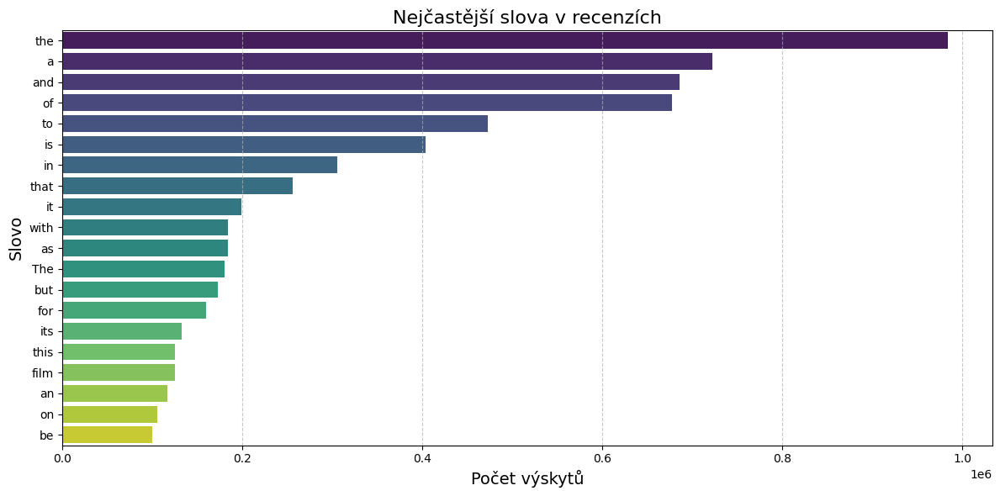

In [34]:
all_words = ' '.join(df['review_content'].dropna()).split()
most_common = Counter(all_words).most_common(20)
most_frequent_words = pd.DataFrame(most_common, columns=['word', 'count'])

plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='word', data=most_frequent_words, hue='word', palette='viridis', legend=False)
plt.title(label='Nejčastější slova v recenzích', fontsize=16)
plt.xlabel('Počet výskytů', fontsize=14)
plt.ylabel('Slovo', fontsize=14)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

#### Nejčastější slova v recenzích bez stop-slov

In [35]:
def clean_text(text):
	if not text:
		return ""
	
	text = re.sub(r'[^\w\s]', '', text.lower()) # převod na malá písmena a odstranění interpunkce
	text = re.sub(r'\d+', '', text) # odstranění čísel
	text = re.sub(r'\s+', ' ', text).strip() # odstranění nadbytečných mezer
	return text

In [36]:
def get_most_frequent_words(text_series, n=20):
	stop_words = set(stopwords.words('english'))
	
	all_texts = text_series.dropna().apply(clean_text)
	all_words = []
	for text in all_texts:
		words = [word for word in text.split() if word not in stop_words and len(word) > 2]
		all_words.extend(words)
	
	most_common = Counter(all_words).most_common(n)
	return pd.DataFrame(most_common, columns=['word', 'count'])

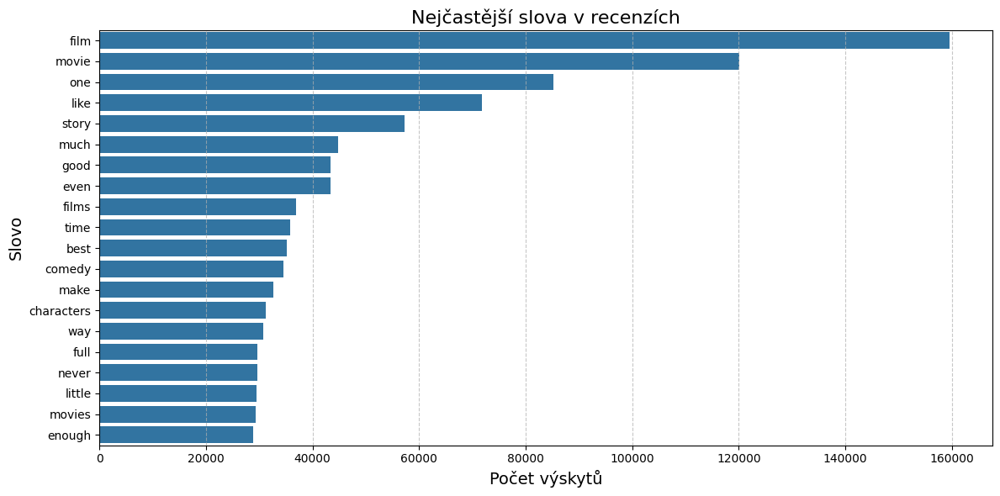

In [37]:
most_frequent_words = get_most_frequent_words(df['review_content'], n=20)

plt.figure(figsize=(12, 6))
sns.barplot(x='count', y='word', data=most_frequent_words)
plt.title('Nejčastější slova v recenzích', fontsize=16)
plt.xlabel('Počet výskytů', fontsize=14)
plt.ylabel('Slovo', fontsize=14)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

##### Nejčastější slova v jednotlivých třídách

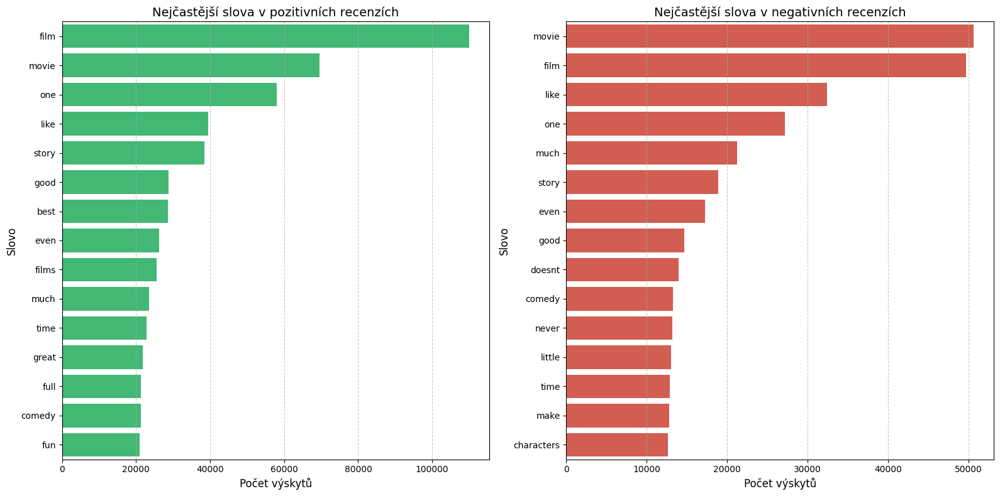

In [38]:
fresh_words = get_most_frequent_words(df[df['review_type'] == 'Fresh']['review_content'], n=15)
fresh_words['category'] = 'Fresh'

rotten_words = get_most_frequent_words(df[df['review_type'] == 'Rotten']['review_content'], n=15)
rotten_words['category'] = 'Rotten'

fig, axes = plt.subplots(1, 2, figsize=(16, 8))

sns.barplot(x='count', y='word', data=fresh_words, color='#2ecc71', ax=axes[0])
axes[0].set_title('Nejčastější slova v pozitivních recenzích', fontsize=14)
axes[0].set_xlabel('Počet výskytů', fontsize=12)
axes[0].set_ylabel('Slovo', fontsize=12)
axes[0].grid(axis='x', linestyle='--', alpha=0.7)

sns.barplot(x='count', y='word', data=rotten_words, color='#e74c3c', ax=axes[1])
axes[1].set_title('Nejčastější slova v negativních recenzích', fontsize=14)
axes[1].set_xlabel('Počet výskytů', fontsize=12)
axes[1].set_ylabel('Slovo', fontsize=12)
axes[1].grid(axis='x', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

### WordCloud

WordCloud je skvělý nástroj pro vizualizaci nejčastějších slov v recenzích. Vytvoříme WordCloud pro pozitivní a negativní recenze zvlášť, abychom viděli, jaká slova jsou nejvíce spojována s každým typem recenze.

In [39]:
def plot_wordcloud(text_series, title):
	stop_words = set(stopwords.words('english'))
	
	all_texts = text_series.dropna().apply(clean_text)

	filtered_texts = []
	for text in all_texts:
		words = [word for word in text.split() if word not in stop_words and len(word) > 2]
		filtered_texts.append(' '.join(words))
	
	all_words = ' '.join(filtered_texts)
	
	wordcloud = WordCloud(
		width=800,
		height=400,
		background_color='white',
		max_words=200
	).generate(all_words)
	
	plt.figure(figsize=(10, 5))
	plt.imshow(wordcloud, interpolation='bilinear')
	plt.axis('off')
	plt.title(title, fontsize=16)
	plt.tight_layout()
	plt.show()

#### Pozitivní recenze (Fresh)

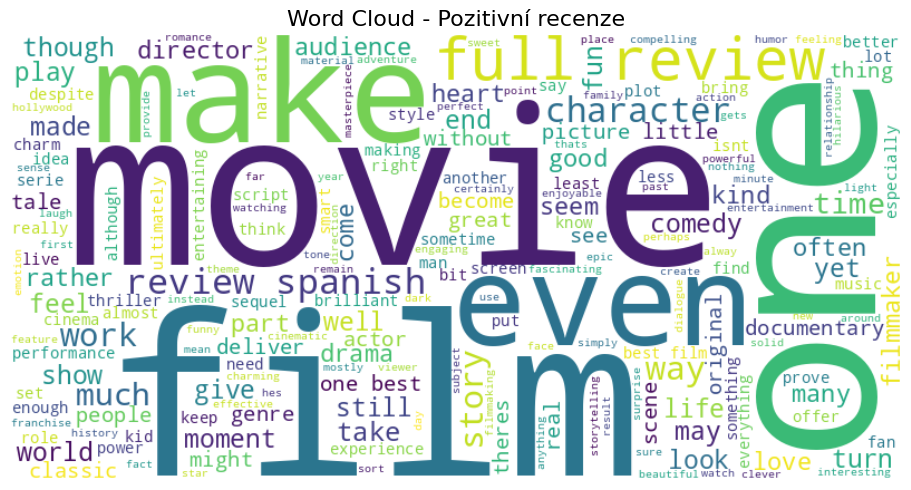

In [40]:
plot_wordcloud(df[df['review_type'] == 'Fresh']['review_content'], 'Word Cloud - Pozitivní recenze')

#### Negativní recenze (Rotten)

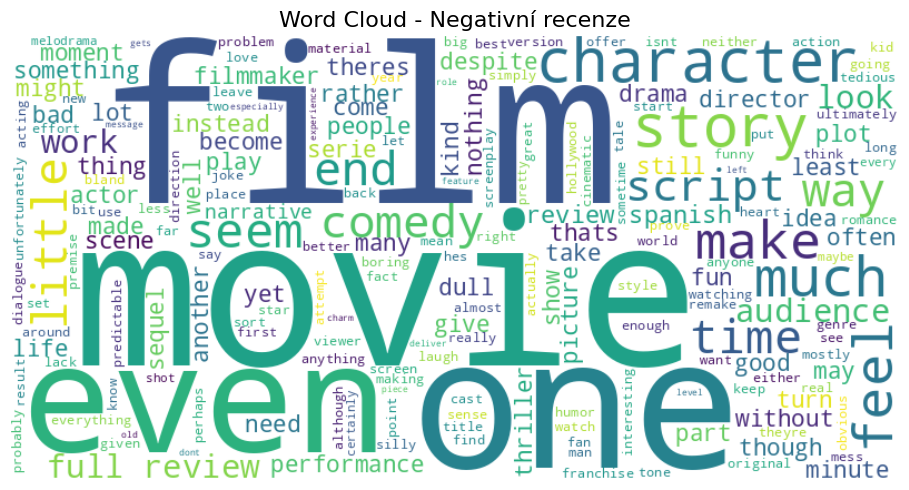

In [41]:
plot_wordcloud(df[df['review_type'] == 'Rotten']['review_content'], 'Word Cloud - Negativní recenze')

# Předzpracování dat

## Zahození nepotřebných sloupců

In [42]:
df = df.drop(columns=columns_to_drop)
df.columns

Index(['review_type', 'review_content'], dtype='object')

## Zahození chybějících hodnot

In [43]:
df.dropna(subset=['review_content'], inplace=True)

## Zahození krátkých recenzí

In [44]:
df = df[df['review_content'].str.len() > 2]

## Předzpracování textu

### Odstranění stop-slov

In [45]:
stop_words = set(stopwords.words('english'))

In [46]:
def remove_stop_words(text):
	if not text:
		return ""
	words = text.split()
	filtered_words = [word for word in words if word.lower() not in stop_words]
	return ' '.join(filtered_words)

In [47]:
df['review_content'] = df['review_content'].apply(remove_stop_words)

### Lemmatizace textu

In [48]:
def lemmatize_text(text):
    lemmatizer = WordNetLemmatizer()
    return ' '.join([lemmatizer.lemmatize(word) for word in text.split()])

In [49]:
df["review_content"] = df["review_content"].apply(lemmatize_text)

### Očištění textu od speciálních znaků  ✂️🔢

- odstraníme speciální znaky a čísla z textu, aby zůstal pouze čistý text 🧹
- převedeme text na malá písmena, aby se zjednodušila analýza a porovnávání slov  🔡
- odstraníme nadbytečné mezery, které mohou vzniknout při odstraňování speciálních znaků a čísel 🚀

In [50]:
def clean_text(text):
    text = re.sub(r'[^a-zA-Z\s]', '', text)  
    text = text.lower()  
    text = text.strip()
    return text

In [51]:
df['review_content'] = df['review_content'].apply(clean_text)

### Převedení cílové proměnné na číselné hodnoty

In [52]:
label_map = {'Fresh': 1, 'Rotten': 0}
df['label'] = df['review_type'].map(label_map)

In [53]:
df.head()

,review_type,review_content,label
0,Fresh,fantasy adventure fuse greek mythology contemp...,1
1,Fresh,uma thurman medusa gorgon coiffure writhing sn...,1
2,Fresh,topnotch cast dazzling special effects tide te...,1
3,Fresh,whether audience get behind lightning thief ha...,1
4,Rotten,whats really lacking lightning thief genuine s...,0


## Rozdělení dat na trénovací a testovací sadu

Jelikož máme až přebytek dat, zkusím vzít náhodný vzorek. Jelikož máme něco málo pod 300 tisíc Rotten recenzí po odstranění chybějících hodnot, zkusíme vzít 50 tisíc náhodných vzorků z obou tříd, abychom měli vybalancovaný dataset. To nám dá celkem 100 tisíc vzorků, což je stále dostatečné množství pro trénink modelu, což už je více než dostatečné množství pro trénink modelu.

In [54]:
def split_dataset(df, train_ratio=0.8, val_ratio=0.1, min_class_count=None):
	class_counts = df['review_type'].value_counts()
	if min_class_count is None:
		min_count = class_counts.min()
	else:
		min_count = min(min_class_count, class_counts.min())
	classes = class_counts.index.tolist()
	
	balanced_df = pd.concat([
		df[df['review_type'] == c].sample(n=min_count, random_state=SEED)
		for c in classes
	]).sample(frac=1, random_state=SEED).reset_index(drop=True)
	
	train_size = int(len(balanced_df) * train_ratio)
	val_size = int(len(balanced_df) * val_ratio)
	
	train_df = balanced_df[:train_size]
	val_df = balanced_df[train_size:train_size + val_size]
	test_df = balanced_df[train_size + val_size:]
	
	print("="*50)
	print(f"Počet tříd: {len(classes)}")
	print(f"Počet vzorků v každé třídě: {min_count:,}")
	print("-"*50)
	print(f"Tréninková sada: {len(train_df):,} vzorků")
	print(train_df['review_type'].value_counts().to_string())
	print("-"*50)
	print(f"Validační sada: {len(val_df):,} vzorků")
	print(val_df['review_type'].value_counts().to_string())
	print("-"*50)
	print(f"Testovací sada: {len(test_df):,} vzorků")
	print(test_df['review_type'].value_counts().to_string())
	print("-"*50)
	print(f"Celkem: {len(balanced_df):,} vzorků")
	print("="*50)
	
	return train_df, val_df, test_df

In [55]:
train_set, val_set, test_set = split_dataset(df, min_class_count=50_000)

Počet tříd: 2
Počet vzorků v každé třídě: 50,000
--------------------------------------------------
Tréninková sada: 80,000 vzorků
review_type
Rotten    40069
Fresh     39931
--------------------------------------------------
Validační sada: 10,000 vzorků
review_type
Rotten    5025
Fresh     4975
--------------------------------------------------
Testovací sada: 10,000 vzorků
review_type
Fresh     5094
Rotten    4906
--------------------------------------------------
Celkem: 100,000 vzorků


In [56]:
X_train = train_set['review_content'].values
y_train = train_set['label'].values

X_val = val_set['review_content'].values
y_val = val_set['label'].values

X_test = test_set['review_content'].values
y_test = test_set['label'].values

print(f"Tréninková sada: {len(X_train)} vzorků")
print(f"Validační sada: {len(X_val)} vzorků")
print(f"Testovací sada: {len(X_test)} vzorků")

Tréninková sada: 80000 vzorků
Validační sada: 10000 vzorků
Testovací sada: 10000 vzorků


## Zvolená metrika

Máme perfektně vybalancovaný dataset, proto jako hlavní hodnotící metriku použijeme přesnost (accuracy). Ta je v tomto případě vhodná, protože obě třídy jsou zastoupeny rovnoměrně a nehrozí zkreslení výsledků ve prospěch početnější třídy.

## Padding & Tokenizace

- **VOCAB_SIZE = 10_000**  
	Zachováme 10 000 nejčastějších slov pro tokenizaci, což je kompromis mezi informací a dostupnou pamětí

- **SEQ_LENGTH = 128**  
	Maximální délka sekvence nastavena na 128 tokenů. Delší texty budou oříznuty, kratší doplněny (padding).
	128 byl i medián délky textů, takže bychom se měli trfit do středu.


In [57]:
VOCAB_SIZE = 10_000    
SEQ_LENGTH = 128       

In [58]:
tokenizer = Tokenizer(num_words=VOCAB_SIZE)
tokenizer.fit_on_texts(X_train)

X_train_seq = tokenizer.texts_to_sequences(X_train)
X_test_seq = tokenizer.texts_to_sequences(X_test)
X_valid_seq = tokenizer.texts_to_sequences(X_val)

X_train_pad = pad_sequences(X_train_seq, maxlen=SEQ_LENGTH, padding='post')
X_test_pad = pad_sequences(X_test_seq, maxlen=SEQ_LENGTH, padding='post')
X_valid_pad = pad_sequences(X_valid_seq, maxlen=SEQ_LENGTH, padding='post')

X_train_pad = np.array(X_train_pad, dtype='int32')
y_train = np.array(y_train, dtype='float32')
X_val_pad = np.array(X_valid_pad, dtype='int32')
y_val = np.array(y_val, dtype='float32')

# Pomocné funkce pro trénování modelů

## Embedding

In [59]:
EMBEDING_DIM = 200

### Custom embedding

In [60]:
def in_emb_layers(words):
    input_layer = Input(shape=(1,), dtype=tf.string)

    vectorization = TextVectorization(max_tokens=VOCAB_SIZE,
                                      output_mode='int',
                                      output_sequence_length=SEQ_LENGTH)
    vectorization.adapt(words)
    vec = vectorization(input_layer)
    emb = Embedding(VOCAB_SIZE, EMBEDING_DIM)(vec)

    return input_layer, emb

### GloVe embedding

In [61]:
if not os.path.exists('data/glove/glove.6B.zip') and not os.path.exists('data/glove/glove.6B.50d.txt'):
    print("Downloading GloVe embeddings...")
    os.makedirs('data/glove', exist_ok=True)
    !wget http://nlp.stanford.edu/data/glove.6B.zip -P data/glove/
else:
    print("GloVe embedding už existují, přeskočím stahování.")

GloVe embedding už existují, přeskočím stahování.


In [62]:
if os.path.exists('data/glove/glove.6B.zip') and not os.path.exists('data/glove/glove.6B.50d.txt'):
    print("Extracting GloVe embeddings...")
    !unzip -q data/glove/glove.6B.zip -d data/glove/
else:
    print("GloVe embeddings již byly extrahovány, přeskočím extrakci.")

GloVe embeddings již byly extrahovány, přeskočím extrakci.


In [63]:
def glove_in_emb_tokenized(input_shape=(SEQ_LENGTH,)):
	path_to_glove_file = f'data/glove/glove.6B.{EMBEDING_DIM}d.txt'

	embeddings_index = {}
	with open(path_to_glove_file) as f:
		for line in f:
			word, coefs = line.split(maxsplit=1)
			coefs = np.fromstring(coefs, "f", sep=" ")
			embeddings_index[word] = coefs

	tokenizer = Tokenizer(num_words=VOCAB_SIZE)
	tokenizer.fit_on_texts(train_set['review_content'].values)
	word_index = tokenizer.word_index
	
	num_tokens = min(VOCAB_SIZE, len(word_index) + 1)
	embedding_matrix = np.zeros((num_tokens, EMBEDING_DIM))
	
	hits = 0
	misses = 0
	
	for word, i in word_index.items():
		if i >= VOCAB_SIZE:
			continue
		embedding_vector = embeddings_index.get(word)
		if embedding_vector is not None:
			embedding_matrix[i] = embedding_vector
			hits += 1
		else:
			misses += 1
	
	print(f"GloVe vektory: {hits} nalezeno a {misses} chybí")
	embed_init = Constant(embedding_matrix)
	
	input_layer = Input(shape=input_shape)
	
	emb = Embedding(
			num_tokens,
			EMBEDING_DIM,
			embeddings_initializer=embed_init,
			trainable=False)(input_layer)

	return input_layer, emb

## Vyhodnocení modelu

In [64]:
class_names = ['Fresh', 'Rotten']

In [65]:
def evaluate_model(model, X_test, y_test):
	y_pred_proba = model.predict(X_test)
	
	if len(y_pred_proba.shape) == 1 or y_pred_proba.shape[1] == 1:
		# převod sigmoid výstupů na binární predikce (0 nebo 1)
		y_pred = (y_pred_proba > 0.5).astype(int)
		if len(y_pred_proba.shape) > 1:
			y_pred = y_pred.flatten()
		
		y_true = y_test
	else:
		y_pred = np.argmax(y_pred_proba, axis=1)
		y_true = np.argmax(y_test, axis=1)
	
	report = classification_report(
		y_true, 
		y_pred, 
		target_names=class_names,
		zero_division=0
	)
	accuracy = accuracy_score(y_true, y_pred)

	print(f"Celková přesnost: {accuracy:.4f}")
	print("\nKlasifikační zpráva:")
	print(report)

	cm = confusion_matrix(y_true, y_pred)
	plt.figure(figsize=(10, 8))
	sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
				xticklabels=class_names,
				yticklabels=class_names)
	plt.xlabel('Predikováno')
	plt.ylabel('Skutečné')
	plt.title(f"Matice záměn (přesnost: {accuracy:.4f})")
	plt.xticks(rotation=45, ha='right')
	plt.tight_layout()
	plt.show()
	
	return accuracy, report

## Vizualizace trénovacího procesu

In [80]:
# you'll get tensorflow history, plot the loss and accuracy
def plot_training_history(history):
	plt.figure(figsize=(14, 5))
	
	plt.subplot(1, 2, 1)
	plt.plot(history.history['loss'], label='Tréninková ztráta')
	plt.plot(history.history['val_loss'], label='Validační ztráta')
	plt.title('Ztráta během trénování')
	plt.xlabel('Epochy')
	plt.ylabel('Ztráta')
	plt.legend()
	plt.grid()

	plt.subplot(1, 2, 2)
	plt.plot(history.history['accuracy'], label='Tréninková přesnost')
	plt.plot(history.history['val_accuracy'], label='Validační přesnost')
	plt.title('Přesnost během trénování')
	plt.xlabel('Epochy')
	plt.ylabel('Přesnost')
	plt.legend()
	plt.grid()

	plt.tight_layout()
	plt.show()

# Trénink modelů

## Parametry modelů

In [66]:
EPOCHS = 10
BATCH_SIZE = 64

### Vytvoření složky pro ukládání modelů

In [67]:
os.makedirs('models/third', exist_ok=True)

### Tensorboard 

In [68]:
tensorboard_log_dir = 'logs/fit/' + time.strftime("%Y%m%d-%H%M%S")
os.makedirs(tensorboard_log_dir, exist_ok=True)

In [69]:
tensorboard_callback = tf.keras.callbacks.TensorBoard(
	log_dir=tensorboard_log_dir,
	histogram_freq=1,
	write_graph=True,
	write_images=True
)

## Model 1

Tento model je navržen pro klasifikaci sentimentu recenzí pomocí neuronové sítě založené na LSTM (Long Short-Term Memory). Níže je popis jednotlivých vrstev a architektury modelu:

### 🏗️ Architektura modelu:
1. **Vstupní vrstva**:  
	- Tvar vstupu je `(SEQ_LENGTH,)`, což odpovídá délce sekvence tokenů po paddingu.

2. **Embedding vrstva**:  
	- Transformuje tokeny na husté vektorové reprezentace o dimenzi `EMBEDING_DIM` (200).  
	- 📚 Pomáhá modelu zachytit význam slov.

3. **LSTM vrstva**:  
	- Obsahuje 128 jednotek a vrací sekvence.  
	- 🧠 Umožňuje modelu zachytit dlouhodobé závislosti v textu.

4. **GlobalAveragePooling1D vrstva**:  
	- Zredukuje sekvence na jednorozměrný vektor pomocí průměrování.  
	- 🌍 Shrnuje informace z celé sekvence.

5. **Husté (Dense) vrstvy**:  
	- První Dense vrstva má 128 neuronů s aktivací `ReLU`.  
	- Druhá Dense vrstva má 64 neuronů s aktivací `ReLU`.  
	- ✨ Přidávají nelinearitu a umožňují modelu zachytit složité vzory.

6. **Dropout vrstvy**:  
	- Dropout 0.5 a 0.3 jsou použity mezi Dense vrstvami.  
	- 🚨 Slouží k prevenci přeučení modelu.

7. **Výstupní vrstva**:  
	- Obsahuje 1 neuron s aktivací `sigmoid`.  
	- 🟢 Produkuje pravděpodobnost, zda je recenze pozitivní (Fresh) nebo negativní (Rotten).

### ⚙️ Kompilace modelu:
- **Optimalizátor**: Adam (adaptivní optimalizace).  
- **Ztrátová funkce**: Binary Crossentropy (pro binární klasifikaci).  
- **Metrika**: Přesnost (accuracy).

In [70]:
def create_model_1(input_shape=(SEQ_LENGTH,)):
	inputs = Input(shape=input_shape)
	
	x = Embedding(VOCAB_SIZE, EMBEDING_DIM)(inputs)
	
	x = LSTM(128, return_sequences=True)(x)
	
	x = GlobalAveragePooling1D()(x)
	
	x = Dense(128, activation='relu')(x)
	x = Dropout(0.5)(x)
	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model

In [71]:
model_1 = create_model_1(input_shape=(SEQ_LENGTH,))
model_1.summary()

I0000 00:00:1749808865.849004    5241 gpu_device.cc:2019] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 6096 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 2070, pci bus id: 0000:01:00.0, compute capability: 7.5


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding (Embedding)           │ (None, 128, 200)       │     2,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ (None, 128, 128)       │       168,448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d        │ (None, 128)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,193,281 (8.37 MB)

 Trainable params: 2,193,281 (8.37 MB)

 Non-trainable params: 0 (0.00 B)

In [72]:
start_time = time.time()
history_1 = model_1.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_1.keras', 
			monitor='val_accuracy',
			save_best_only=True,
		),
        tensorboard_callback
	],
)
train_time_1 = time.time() - start_time
print(f"Trénink modelu 1 trval {train_time_1:.2f} sekund.")

Epoch 1/10


I0000 00:00:1749808869.525661    5909 cuda_dnn.cc:529] Loaded cuDNN version 90501


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step - accuracy: 0.5019 - loss: 0.6944

2025-06-13 12:02:07.327864: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 63s 48ms/step - accuracy: 0.5019 - loss: 0.6944 - val_accuracy: 0.4975 - val_loss: 0.6976
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - accuracy: 0.5584 - loss: 0.6733 - val_accuracy: 0.7516 - val_loss: 0.5150
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 44s 35ms/step - accuracy: 0.7856 - loss: 0.4667 - val_accuracy: 0.7517 - val_loss: 0.5315
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 42s 33ms/step - accuracy: 0.8367 - loss: 0.3711 - val_accuracy: 0.7182 - val_loss: 0.6621
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 45s 36ms/step - accuracy: 0.8803 - loss: 0.2823 - val_accuracy: 0.7298 - val_loss: 0.6304
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 47s 37ms/step - accuracy: 0.9104 - loss: 0.2200 - val_accuracy: 0.7219 - val_loss: 0.7823
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 48s 38ms/step - accuracy: 0.9284 - loss: 0.1785 - val_accuracy: 0.7193 - val_loss: 1.0156
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 47s 38ms/step - accuracy: 0.9449 - loss: 0.14

  9/313 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step   

2025-06-13 12:08:59.921481: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
Celková přesnost: 0.7286

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.72      0.73      0.72      4906
      Rotten       0.74      0.73      0.73      5094

    accuracy                           0.73     10000
   macro avg       0.73      0.73      0.73     10000
weighted avg       0.73      0.73      0.73     10000



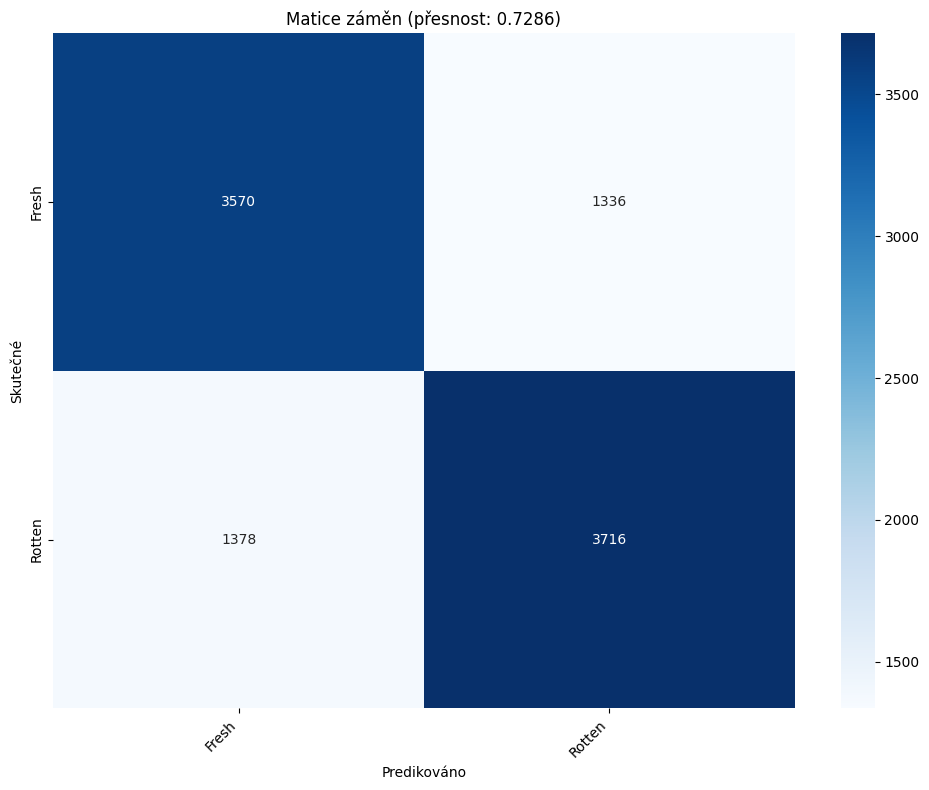

In [73]:
acc_1, report_1 = evaluate_model(model_1, X_test_pad, y_test)

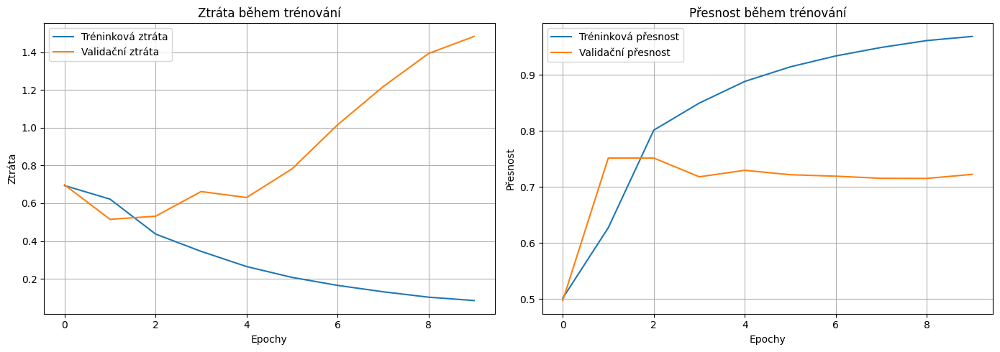

In [81]:
plot_training_history(history_1)

## Model 2

Architektura tohoto modelu je stejná jako u předchozího modelu, jedinou změnou je použití předtrénovaných GloVe embeddingů 📚 v embedding vrstvě. Tyto embeddingy jsou inicializovány maticí GloVe a nejsou trénovatelné. 🔒


In [74]:
def create_model_2():
	inputs, x = glove_in_emb_tokenized()
	
	x = LSTM(128, return_sequences=True)(x)
	
	x = GlobalAveragePooling1D()(x)
	
	x = Dense(128, activation='relu')(x)
	x = Dropout(0.5)(x)
	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model

In [75]:
model_2 = create_model_2()
model_2.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding_1 (Embedding)         │ (None, 128, 200)       │     2,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 128, 128)       │       168,448 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_1      │ (None, 128)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,193,281 (8.37 MB)

 Trainable params: 193,281 (755.00 KB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [76]:
start_time = time.time()
history_2 = model_2.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_2.keras', 
			monitor='val_accuracy',
			save_best_only=True,
		),
        tensorboard_callback
	],
)
train_time_2 = time.time() - start_time
print(f"Trénink modelu 2 trval {train_time_2:.2f} sekund.")

Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.6802 - loss: 0.5933

2025-06-13 12:09:51.530316: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 40s 30ms/step - accuracy: 0.6803 - loss: 0.5933 - val_accuracy: 0.7177 - val_loss: 0.5388
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 37s 29ms/step - accuracy: 0.7508 - loss: 0.5087 - val_accuracy: 0.7487 - val_loss: 0.5088
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 37s 29ms/step - accuracy: 0.7748 - loss: 0.4738 - val_accuracy: 0.7540 - val_loss: 0.5007
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 31s 25ms/step - accuracy: 0.7956 - loss: 0.4422 - val_accuracy: 0.7477 - val_loss: 0.5100
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 31s 25ms/step - accuracy: 0.8165 - loss: 0.4074 - val_accuracy: 0.7508 - val_loss: 0.5199
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 33s 27ms/step - accuracy: 0.8400 - loss: 0.3727 - val_accuracy: 0.7471 - val_loss: 0.5450
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 34s 27ms/step - accuracy: 0.8584 - loss: 0.3364 - val_accuracy: 0.7406 - val_loss: 0.5672
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 34s 27ms/step - accuracy: 0.8755 - loss: 0.30

 10/313 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step   

2025-06-13 12:15:00.783719: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step
Celková přesnost: 0.7338

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.79      0.62      0.70      4906
      Rotten       0.70      0.84      0.76      5094

    accuracy                           0.73     10000
   macro avg       0.75      0.73      0.73     10000
weighted avg       0.74      0.73      0.73     10000



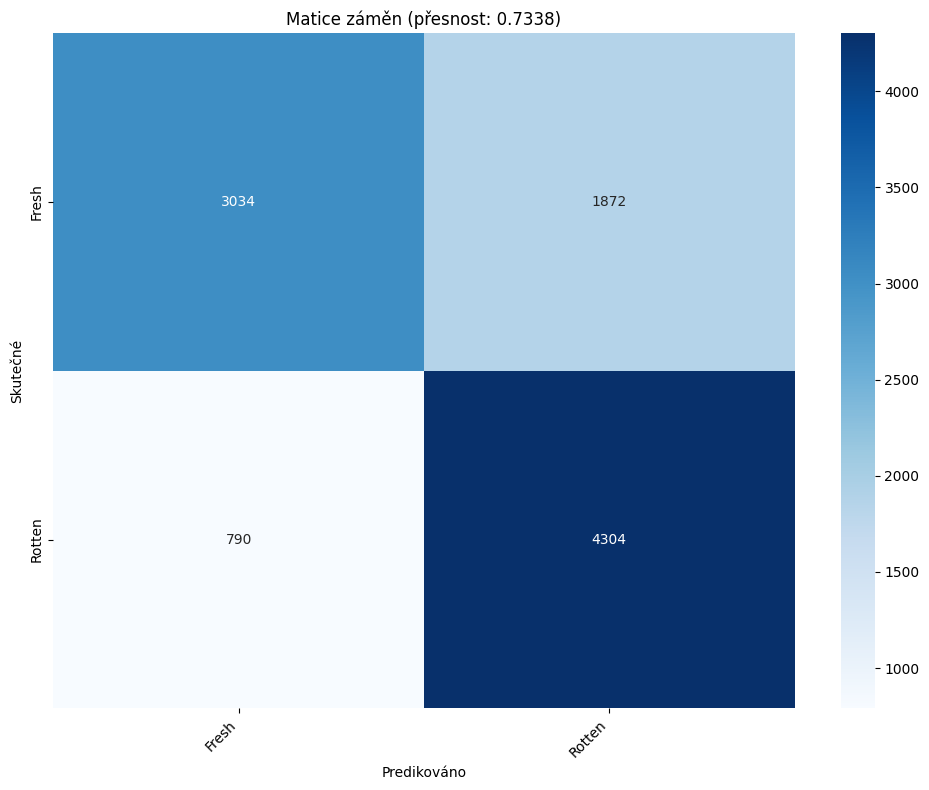

In [77]:
acc_2, report_2 = evaluate_model(model_2, X_test_pad, y_test)

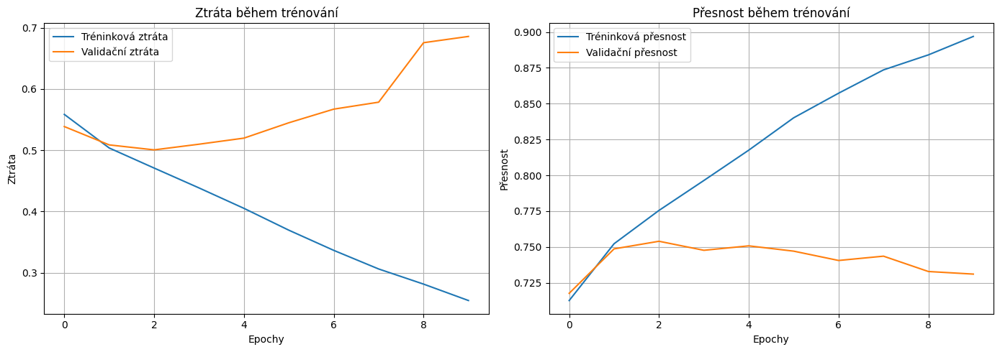

In [82]:
plot_training_history(history_2)

In [78]:
print(f"Model 1 - doba trénování: {train_time_1:.2f} sekund, Přesnost: {acc_1:.4f}")
print(f"Model 2 - doba trénování: {train_time_2:.2f} sekund, Přesnost: {acc_2:.4f}")

Model 1 - doba trénování: 473.03 sekund, Přesnost: 0.7286
Model 2 - doba trénování: 345.29 sekund, Přesnost: 0.7338


### Porovnání modelů

První model využíval **custom embedding**, zatímco druhý model používal **GloVe embedding**. Na základě výsledků je druhý model přesnější (přesnost: **73.38 %**) než první model (přesnost: **72.86 %**). Proto se rozhodneme pokračovat s modelem využívajícím **GloVe embedding**. I čas trénování byl u druhého modelu kratší, což je další výhoda.

## Tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs

## Model 3 - více vrstev

In [ ]:
def create_model_3():
	inputs, x = glove_in_emb_tokenized()

	x = LSTM(256, return_sequences=True)(x)
	x = Dropout(0.3)(x)
	
	x = GlobalAveragePooling1D()(x)
	
	x = Dense(256, activation='relu')(x)
	x = Dropout(0.5)(x)
	
	x = Dense(192, activation='relu')(x)
	x = Dropout(0.4)(x)
	
	x = Dense(128, activation='relu')(x)
	x = Dropout(0.4)(x)
	
	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model


In [103]:
model_3 = create_model_3()
model_3.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_5 (InputLayer)      │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding_5 (Embedding)         │ (None, 128, 200)       │     2,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_8 (LSTM)                   │ (None, 128, 256)       │       467,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_12 (Dropout)            │ (None, 128, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_4      │ (None, 256)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 192)            │        49,344 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_14 (Dropout)            │ (None, 192)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 128)            │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_15 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_16 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,616,129 (9.98 MB)

 Trainable params: 616,129 (2.35 MB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [104]:
start_time = time.time()
history_3 = model_3.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_3.keras', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_3 = time.time() - start_time
print(f"Trénink modelu 3 trval {train_time_3:.2f} sekund.")

Epoch 1/10
1249/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - accuracy: 0.6463 - loss: 0.6159

2025-06-13 12:38:57.305693: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 81s 63ms/step - accuracy: 0.6464 - loss: 0.6159 - val_accuracy: 0.7237 - val_loss: 0.5366
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 67s 53ms/step - accuracy: 0.7499 - loss: 0.5145 - val_accuracy: 0.7475 - val_loss: 0.5115
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 58s 46ms/step - accuracy: 0.7734 - loss: 0.4786 - val_accuracy: 0.7473 - val_loss: 0.5111
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 48s 39ms/step - accuracy: 0.7961 - loss: 0.4421 - val_accuracy: 0.7588 - val_loss: 0.5047
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 53s 42ms/step - accuracy: 0.8229 - loss: 0.3986 - val_accuracy: 0.7486 - val_loss: 0.5464
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 46s 37ms/step - accuracy: 0.8512 - loss: 0.3456 - val_accuracy: 0.7510 - val_loss: 0.5859
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 45s 36ms/step - accuracy: 0.8771 - loss: 0.2946 - val_accuracy: 0.7394 - val_loss: 0.6960
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 46s 37ms/step - accuracy: 0.8983 - loss: 0.25

  8/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step   

2025-06-13 12:46:41.358623: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
Celková přesnost: 0.7431

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.75      0.71      0.73      4906
      Rotten       0.73      0.78      0.76      5094

    accuracy                           0.74     10000
   macro avg       0.74      0.74      0.74     10000
weighted avg       0.74      0.74      0.74     10000



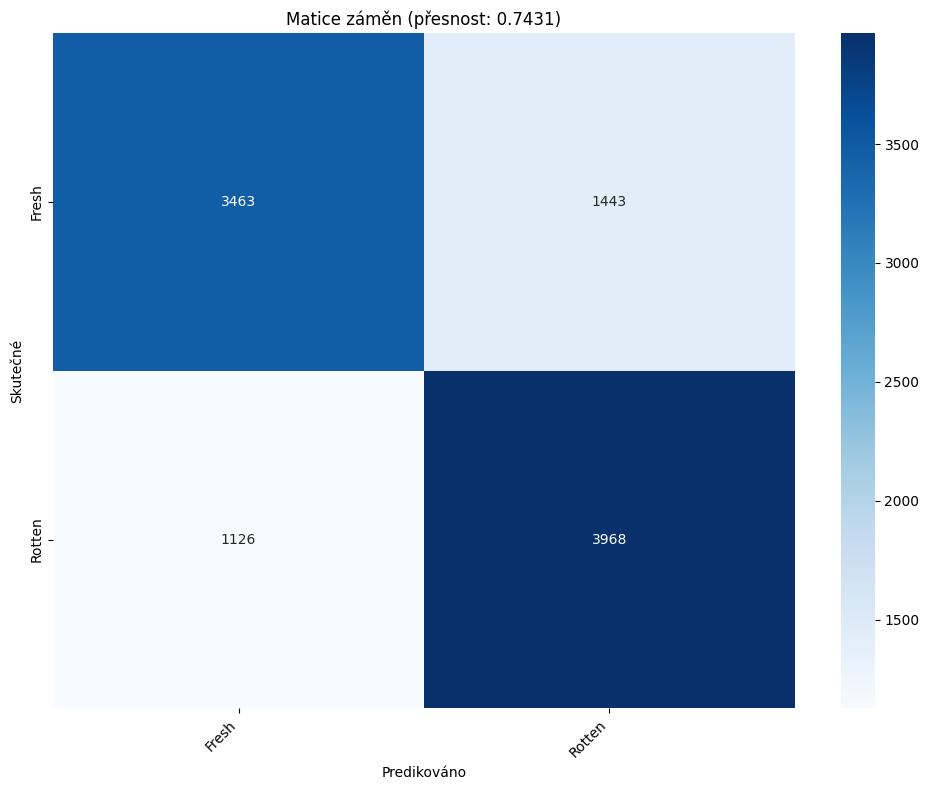

In [105]:
acc_3, report_3 = evaluate_model(model_3, X_test_pad, y_test)

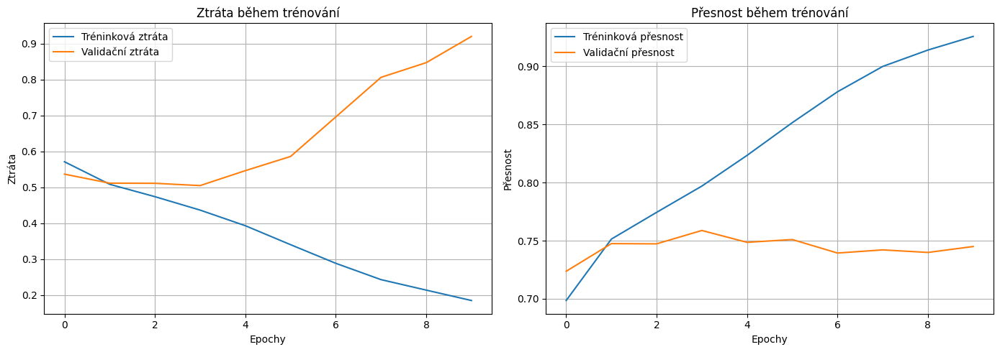

In [106]:
plot_training_history(history_3)

In [107]:
print(f"Přesnost modelu 2: {acc_2:.4f}")
print(f"Přesnost modelu 3: {acc_3:.4f}")

Přesnost modelu 2: 0.7338
Přesnost modelu 3: 0.7431


Parádá! Dosáhli jsme vyšší přesnosti s novým modelem, který má více vrstev. Zkusíme pokračovat v stejném duchu a přidat další vrstvy do modelu.

## Model 4 - více více vrstev

In [ ]:
def create_model_4():
	inputs, x = glove_in_emb_tokenized()
	
	x = LSTM(384, return_sequences=True)(x)
	x = Dropout(0.3)(x)
	
	x = GlobalAveragePooling1D()(x)
	
	x = Dense(512, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.5)(x)
	
	x = Dense(384, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.5)(x)
	
	x = Dense(256, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.4)(x)
	
	x = Dense(192, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.4)(x)
	
	x = Dense(128, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.3)(x)
	
	x = Dense(64, activation='relu')(x)
	x = BatchNormalization()(x)
	x = Dropout(0.2)(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model


In [109]:
model_4 = create_model_4()
model_4.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)      │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding_6 (Embedding)         │ (None, 128, 200)       │     2,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_9 (LSTM)                   │ (None, 128, 384)       │       898,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_17 (Dropout)            │ (None, 128, 384)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_5      │ (None, 384)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 512)            │       197,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_18 (Dropout)            │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 384)            │       196,992 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 384)            │         1,536 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_19 (Dropout)            │ (None, 384)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_22 (Dense)                │ (None, 256)            │        98,560 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_20 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 192)            │        49,344 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 192)            │           768 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_21 (Dropout)            │ (None, 192)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 128)            │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_22 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 64)             │           25

 Total params: 3,479,745 (13.27 MB)

 Trainable params: 1,476,673 (5.63 MB)

 Non-trainable params: 2,003,072 (7.64 MB)

In [110]:
start_time = time.time()
history_4 = model_4.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_4.keras', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_4 = time.time() - start_time
print(f"Trénink modelu 4 trval {train_time_4:.2f} sekund.")

Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step - accuracy: 0.5671 - loss: 0.7098

2025-06-13 12:51:53.386114: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 130s 100ms/step - accuracy: 0.5671 - loss: 0.7098 - val_accuracy: 0.5138 - val_loss: 1.2277
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 88s 71ms/step - accuracy: 0.7283 - loss: 0.5360 - val_accuracy: 0.6686 - val_loss: 0.6010
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 81s 64ms/step - accuracy: 0.7485 - loss: 0.5095 - val_accuracy: 0.5332 - val_loss: 2.0912
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 91s 73ms/step - accuracy: 0.7649 - loss: 0.4857 - val_accuracy: 0.7591 - val_loss: 0.5030
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 88s 70ms/step - accuracy: 0.7800 - loss: 0.4596 - val_accuracy: 0.6279 - val_loss: 0.7016
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 138s 68ms/step - accuracy: 0.8004 - loss: 0.4303 - val_accuracy: 0.6018 - val_loss: 0.8328
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 89s 71ms/step - accuracy: 0.8241 - loss: 0.3932 - val_accuracy: 0.6784 - val_loss: 0.6552
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 84s 68ms/step - accuracy: 0.8521 - loss: 0

2025-06-13 13:05:53.029603: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 4s 13ms/step
Celková přesnost: 0.6957

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.64      0.86      0.74      4906
      Rotten       0.80      0.53      0.64      5094

    accuracy                           0.70     10000
   macro avg       0.72      0.70      0.69     10000
weighted avg       0.72      0.70      0.69     10000



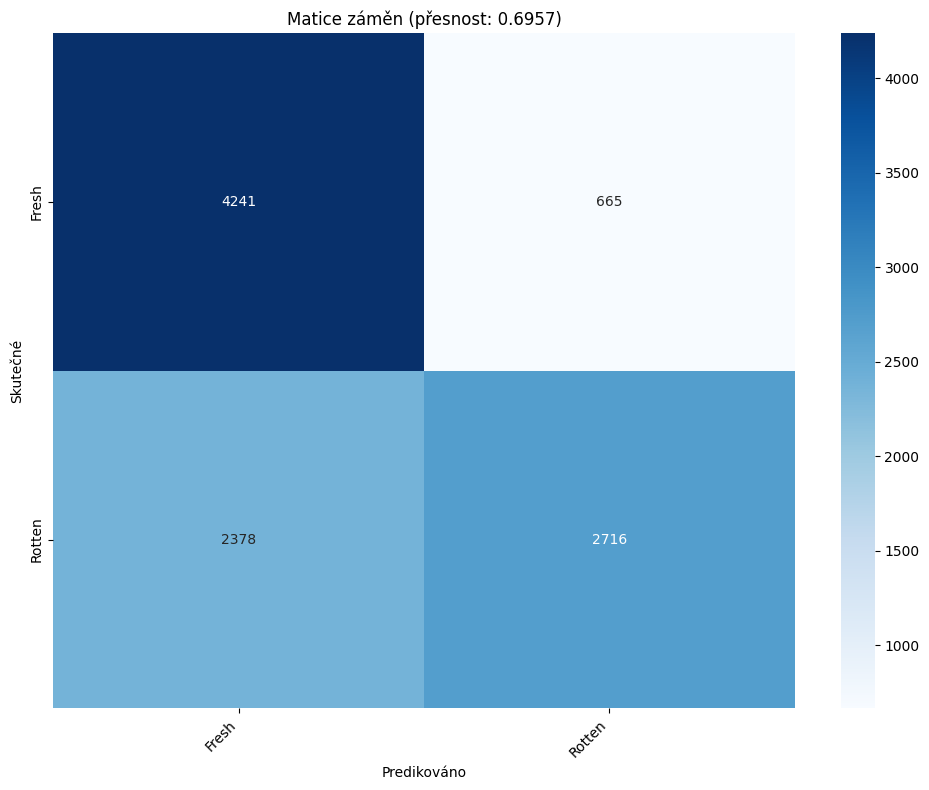

In [111]:
acc_4, report_4 = evaluate_model(model_4, X_test_pad, y_test)

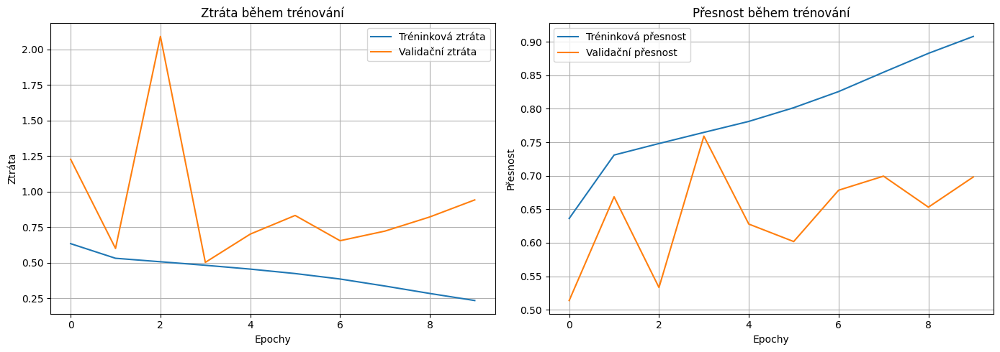

In [112]:
plot_training_history(history_4)

In [113]:
print(f"Přesnost modelu 3: {acc_3:.4f}")
print(f"Přesnost modelu 4: {acc_4:.4f}")

Přesnost modelu 3: 0.7431
Přesnost modelu 4: 0.6957


Přidání jetště více vrstev vedlo k horšímu výsledku, což je překvapivé. Pro další experimenty použijeme model 3.

## Model 5 - více dvousměrných vrstev

In [114]:
def create_model_5():
	inputs, x = glove_in_emb_tokenized()
	
	x = Bidirectional(LSTM(128, return_sequences=True))(x)
	x = Dropout(0.3)(x)
	
	x = Bidirectional(LSTM(128, return_sequences=True))(x)
	x = Dropout(0.3)(x)
	
	x = GlobalAveragePooling1D()(x)
	
	x = Dense(256, activation='relu')(x)
	x = Dropout(0.5)(x)
	
	x = Dense(192, activation='relu')(x)
	x = Dropout(0.4)(x)
	
	x = Dense(128, activation='relu')(x)
	x = Dropout(0.4)(x)
	
	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model


In [115]:
model_5 = create_model_5()
model_5.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_7"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_7 (InputLayer)      │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ embedding_7 (Embedding)         │ (None, 128, 200)       │     2,000,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional (Bidirectional)   │ (None, 128, 256)       │       336,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_24 (Dropout)            │ (None, 128, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ bidirectional_1 (Bidirectional) │ (None, 128, 256)       │       394,240 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_25 (Dropout)            │ (None, 128, 256)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling1d_6      │ (None, 256)            │             0 │
│ (GlobalAveragePooling1D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_26 (Dropout)            │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 192)            │        49,344 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_27 (Dropout)            │ (None, 192)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 128)            │        24,704 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_28 (Dropout)            │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_29 (Dropout)            │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 1)              │            65 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,879,297 (10.98 MB)

 Trainable params: 879,297 (3.35 MB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [116]:
start_time = time.time()
history_5 = model_5.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_5.keras', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_5 = time.time() - start_time
print(f"Trénink modelu 5 trval {train_time_5:.2f} sekund.")

Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step - accuracy: 0.6742 - loss: 0.5918

2025-06-13 13:12:01.012853: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 125s 96ms/step - accuracy: 0.6743 - loss: 0.5918 - val_accuracy: 0.7379 - val_loss: 0.5374
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 120s 96ms/step - accuracy: 0.7518 - loss: 0.5080 - val_accuracy: 0.7484 - val_loss: 0.5217
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 117s 93ms/step - accuracy: 0.7789 - loss: 0.4704 - val_accuracy: 0.7541 - val_loss: 0.4996
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 116s 93ms/step - accuracy: 0.8005 - loss: 0.4313 - val_accuracy: 0.7559 - val_loss: 0.5137
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 115s 92ms/step - accuracy: 0.8238 - loss: 0.3940 - val_accuracy: 0.7493 - val_loss: 0.5390
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 86s 69ms/step - accuracy: 0.8467 - loss: 0.3506 - val_accuracy: 0.7444 - val_loss: 0.5738
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 91s 73ms/step - accuracy: 0.8695 - loss: 0.3094 - val_accuracy: 0.7436 - val_loss: 0.6574
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 83s 66ms/step - accuracy: 0.8871 - loss:

2025-06-13 13:27:18.957321: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 7s 22ms/step
Celková přesnost: 0.7132

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.82      0.53      0.64      4906
      Rotten       0.66      0.89      0.76      5094

    accuracy                           0.71     10000
   macro avg       0.74      0.71      0.70     10000
weighted avg       0.74      0.71      0.70     10000



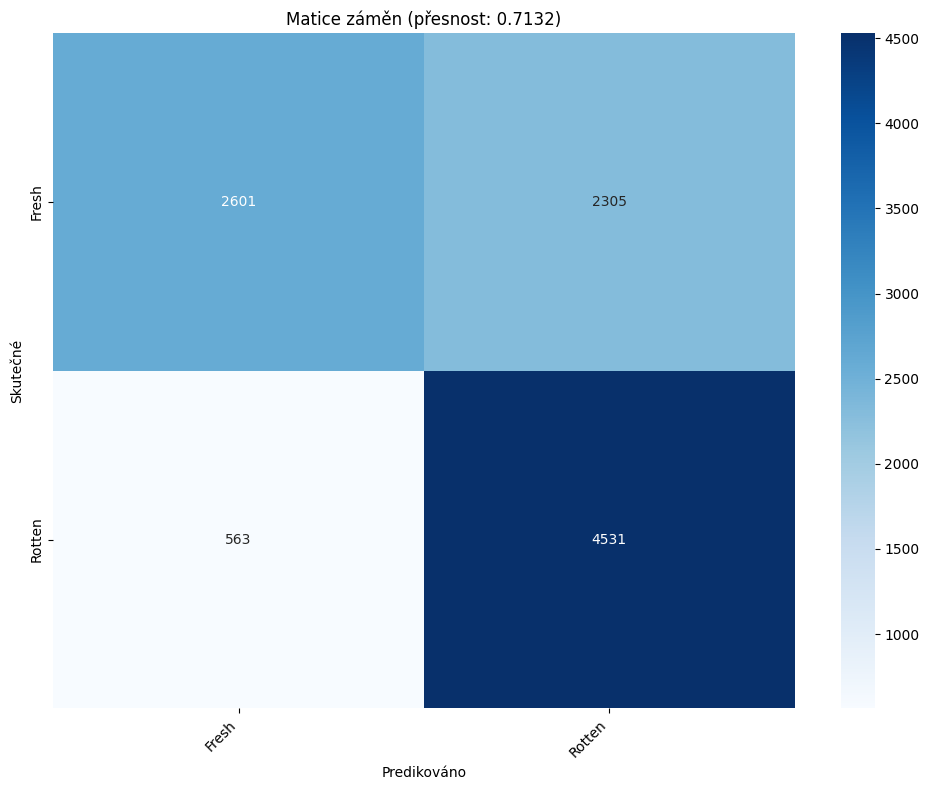

In [117]:
acc_5, report_5 = evaluate_model(model_5, X_test_pad, y_test)

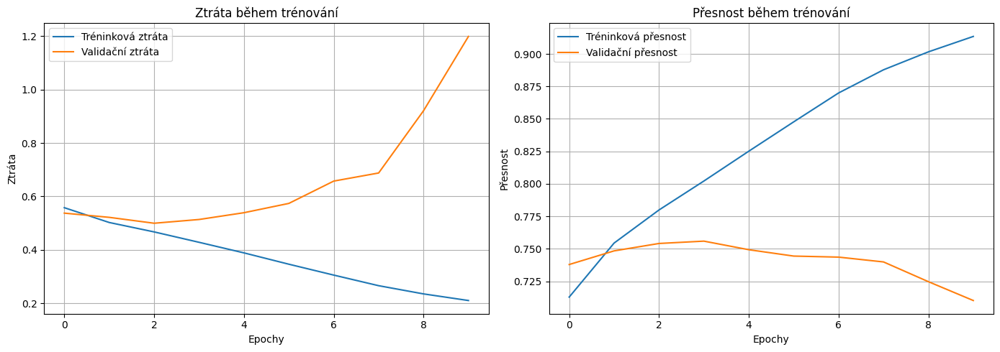

In [118]:
plot_training_history(history_5)

In [119]:
print(f"Přesnost modelu 3: {acc_3:.4f}")
print(f"Přesnost modelu 5: {acc_5:.4f}")

Přesnost modelu 3: 0.7431
Přesnost modelu 5: 0.7132


Model 3 dosáhl nejvyšší přesnosti a bude nejlepší volbou pro další experimenty. Naopak model 5, který obsahoval více dvousměrných vrstev, dosáhl nižší přesnosti. Proto se rozhodneme pokračovat s modelem 3, který nabízí optimální rovnováhu mezi složitostí a výkonem.

## Model 6 - Attention vrstva

In [ ]:
def create_model_6():
	inputs, x = glove_in_emb_tokenized()

	x = LSTM(256, return_sequences=True)(x)
	x = Dropout(0.3)(x)

	attention = Dense(1, activation='tanh')(x)
	attention = Flatten()(attention)
	attention = Activation('softmax')(attention)
	attention = RepeatVector(256)(attention)
	attention = Permute([2, 1])(attention)
	x = Multiply()([x, attention])
	x = Lambda(lambda z: K.sum(z, axis=1), output_shape=(256,))(x)  # Summing over the time steps

	x = Dense(256, activation='relu')(x)
	x = Dropout(0.5)(x)

	x = Dense(192, activation='relu')(x)
	x = Dropout(0.4)(x)

	x = Dense(128, activation='relu')(x)
	x = Dropout(0.4)(x)

	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)

	outputs = Dense(1, activation='sigmoid')(x)

	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model


In [132]:
model_6 = create_model_6()
model_6.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_9"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_10      │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_10        │ (None, 128, 200)  │  2,000,000 │ input_layer_10[0… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lstm_14 (LSTM)      │ (None, 128, 256)  │    467,968 │ embedding_10[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_36          │ (None, 128, 256)  │          0 │ lstm_14[0][0]     │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_39 (Dense)    │ (None, 128, 1)    │        257 │ dropout_36[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_2 (Flatten) │ (None, 128)       │          0 │ dense_39[0][0]    │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 128)       │          0 │ flatten_2[0][0]   │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ repeat_vector_2     │ (None, 256, 128)  │          0 │ activation_2[0][… │
│ (RepeatVector)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ permute_2 (Permute) │ (None, 128, 256)  │          0 │ repeat_vector_2[… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_2          │ (None, 128, 256)  │          0 │ dropout_36[0][0], │
│ (Multiply)          │                   │            │ permute_2[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda (Lambda)     │ (None, 256)       │          0 │ multiply_2[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_40 (Dense)    │ (None, 256)       │     65,792 │ lambda[0][0]      │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_37          │ (None, 256)       │          0 │ dense_40[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_41 (Dense)    │ (None, 192)       │     49,344 │ dropout_37[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_38          │ (None, 192)       │          0 │ dense_41[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_42 (Dense)    │ (None, 128)       │     24,704 │ dropout_38[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_39          │ (None, 128)       │          0 │ dense_42[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_43 (Dense)    │ (None, 64)        │      8,256 │ dropout_39[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_40          │ (None, 64)        │          0 │ dense_43[0][0]    │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_44 (Dense)    │ (None, 1)         │         65 │ dropout_40[0][0]

 Total params: 2,616,386 (9.98 MB)

 Trainable params: 616,386 (2.35 MB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [133]:
start_time = time.time()
history_6 = model_6.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_6.keras', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_6 = time.time() - start_time
print(f"Trénink modelu 6 trval {train_time_6:.2f} sekund.")

Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step - accuracy: 0.6738 - loss: 0.5908

2025-06-13 13:44:49.441681: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 76s 58ms/step - accuracy: 0.6738 - loss: 0.5908 - val_accuracy: 0.7370 - val_loss: 0.5216
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 61s 49ms/step - accuracy: 0.7532 - loss: 0.5072 - val_accuracy: 0.7496 - val_loss: 0.5039
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 50s 40ms/step - accuracy: 0.7754 - loss: 0.4723 - val_accuracy: 0.7518 - val_loss: 0.5057
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 56s 45ms/step - accuracy: 0.8007 - loss: 0.4358 - val_accuracy: 0.7528 - val_loss: 0.5208
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 52s 41ms/step - accuracy: 0.8236 - loss: 0.3936 - val_accuracy: 0.7465 - val_loss: 0.5277
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 52s 42ms/step - accuracy: 0.8502 - loss: 0.3423 - val_accuracy: 0.7417 - val_loss: 0.5767
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 52s 42ms/step - accuracy: 0.8738 - loss: 0.2995 - val_accuracy: 0.7339 - val_loss: 0.6236
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 54s 43ms/step - accuracy: 0.8927 - loss: 0.25

  1/313 ━━━━━━━━━━━━━━━━━━━━ 1:09 223ms/step

2025-06-13 13:53:05.262156: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 10ms/step
Celková přesnost: 0.7344

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.79      0.63      0.70      4906
      Rotten       0.70      0.84      0.76      5094

    accuracy                           0.73     10000
   macro avg       0.74      0.73      0.73     10000
weighted avg       0.74      0.73      0.73     10000



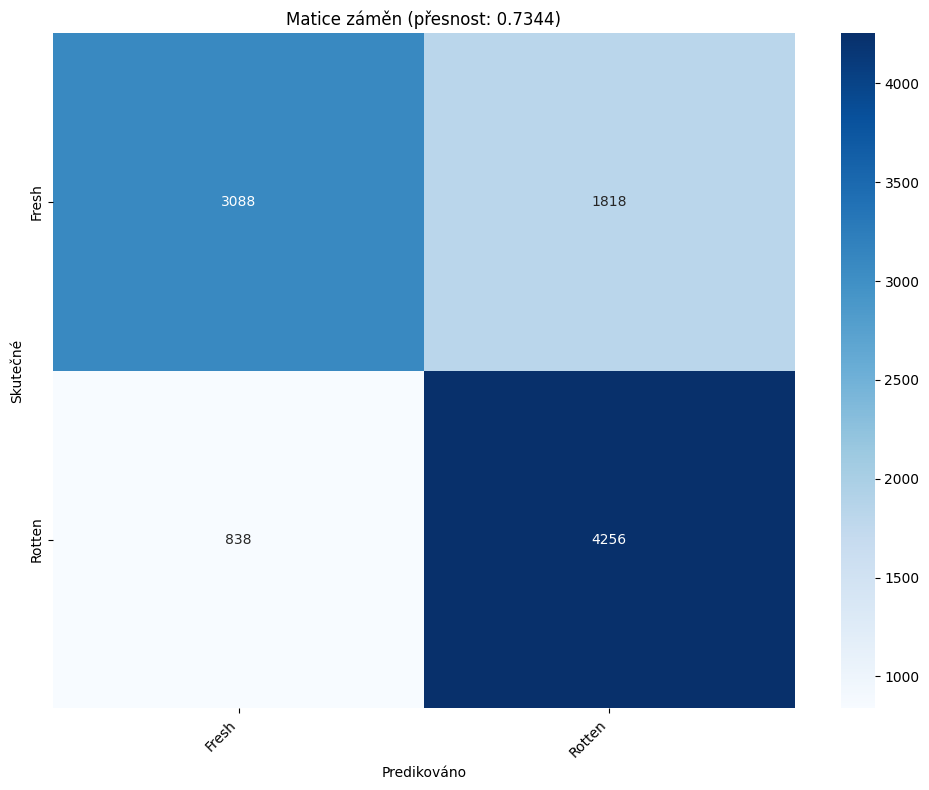

In [134]:
acc_6, report_6 = evaluate_model(model_6, X_test_pad, y_test)

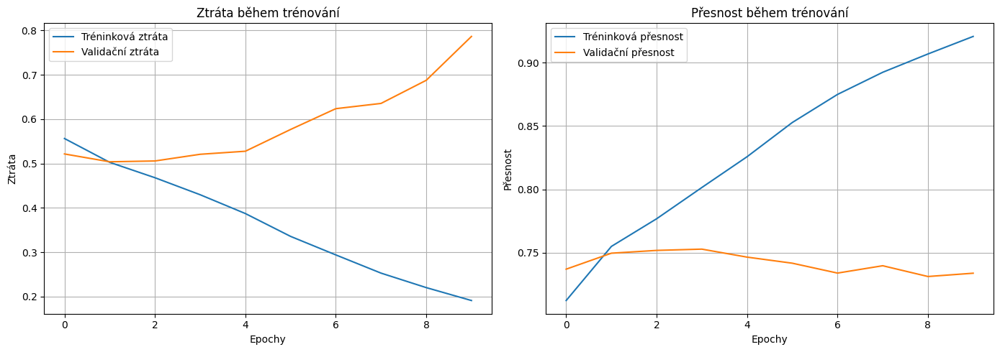

In [135]:
plot_training_history(history_6)

In [137]:
print(f"Přesnost modelu 3: {acc_3:.4f}")
print(f"Přesnost modelu 6: {acc_6:.4f}")

Přesnost modelu 3: 0.7431
Přesnost modelu 6: 0.7344


Opět jsme nedosáhli lepšího výsledku, než u modelu 3. Model 6 sice obsahuje Attention vrstvu, ale její přínos v tomto případě není dostatečný k překonání výkonu modelu 3.

## Model 7 - All in One

In [ ]:
def create_model_7():
	inputs, x = glove_in_emb_tokenized()

	x = Bidirectional(LSTM(128, return_sequences=True))(x)
	x = Dropout(0.3)(x)

	attention = Dense(1, activation='tanh')(x)
	attention = Flatten()(attention)
	attention = Activation('softmax')(attention)
	attention = RepeatVector(256)(attention)
	attention = Permute([2, 1])(attention)
	x = Multiply()([x, attention])
	x = Lambda(lambda z: K.sum(z, axis=1), output_shape=(256,))(x)

	x = Dense(128, activation='relu')(x)
	x = Dropout(0.4)(x)
	x = Dense(64, activation='relu')(x)
	x = Dropout(0.3)(x)

	outputs = Dense(1, activation='sigmoid')(x)

	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer='adam',
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model

In [382]:
model_7 = create_model_7()
model_7.summary()

GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_44"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_48      │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_48        │ (None, 128, 200)  │  2,000,000 │ input_layer_48[0… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_39    │ (None, 128, 256)  │    336,896 │ embedding_48[0][… │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_146         │ (None, 128, 256)  │          0 │ bidirectional_39… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_184 (Dense)   │ (None, 128, 1)    │        257 │ dropout_146[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_40          │ (None, 128)       │          0 │ dense_184[0][0]   │
│ (Flatten)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_40       │ (None, 128)       │          0 │ flatten_40[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ repeat_vector_40    │ (None, 256, 128)  │          0 │ activation_40[0]… │
│ (RepeatVector)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ permute_40          │ (None, 128, 256)  │          0 │ repeat_vector_40… │
│ (Permute)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_40         │ (None, 128, 256)  │          0 │ dropout_146[0][0… │
│ (Multiply)          │                   │            │ permute_40[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda_37 (Lambda)  │ (None, 256)       │          0 │ multiply_40[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_185 (Dense)   │ (None, 128)       │     32,896 │ lambda_37[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_147         │ (None, 128)       │          0 │ dense_185[0][0]   │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_186 (Dense)   │ (None, 64)        │      8,256 │ dropout_147[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_148         │ (None, 64)        │          0 │ dense_186[0][0]   │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_187 (Dense)   │ (None, 1)         │         65 │ dropout_148[0][0] │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,378,370 (9.07 MB)

 Trainable params: 378,370 (1.44 MB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [383]:
start_time = time.time()
history_7 = model_7.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=BATCH_SIZE,
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_7.keras', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_7 = time.time() - start_time
print(f"Trénink modelu 7 trval {train_time_7:.2f} sekund.")

Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - accuracy: 0.6837 - loss: 0.5835

2025-06-13 23:17:03.547107: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 62s 46ms/step - accuracy: 0.6838 - loss: 0.5835 - val_accuracy: 0.7261 - val_loss: 0.5281
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 56s 45ms/step - accuracy: 0.7522 - loss: 0.5028 - val_accuracy: 0.7409 - val_loss: 0.5033
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 56s 44ms/step - accuracy: 0.7772 - loss: 0.4675 - val_accuracy: 0.7480 - val_loss: 0.4945
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 54s 43ms/step - accuracy: 0.7989 - loss: 0.4326 - val_accuracy: 0.7473 - val_loss: 0.5015
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 86s 45ms/step - accuracy: 0.8246 - loss: 0.3919 - val_accuracy: 0.7515 - val_loss: 0.5167
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 56s 44ms/step - accuracy: 0.8494 - loss: 0.3455 - val_accuracy: 0.7560 - val_loss: 0.5403
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 54s 43ms/step - accuracy: 0.8722 - loss: 0.2995 - val_accuracy: 0.7498 - val_loss: 0.5883
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 54s 43ms/step - accuracy: 0.8926 - loss: 0.25

2025-06-13 23:25:45.220774: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step
Celková přesnost: 0.7481

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.76      0.71      0.73      4906
      Rotten       0.74      0.79      0.76      5094

    accuracy                           0.75     10000
   macro avg       0.75      0.75      0.75     10000
weighted avg       0.75      0.75      0.75     10000



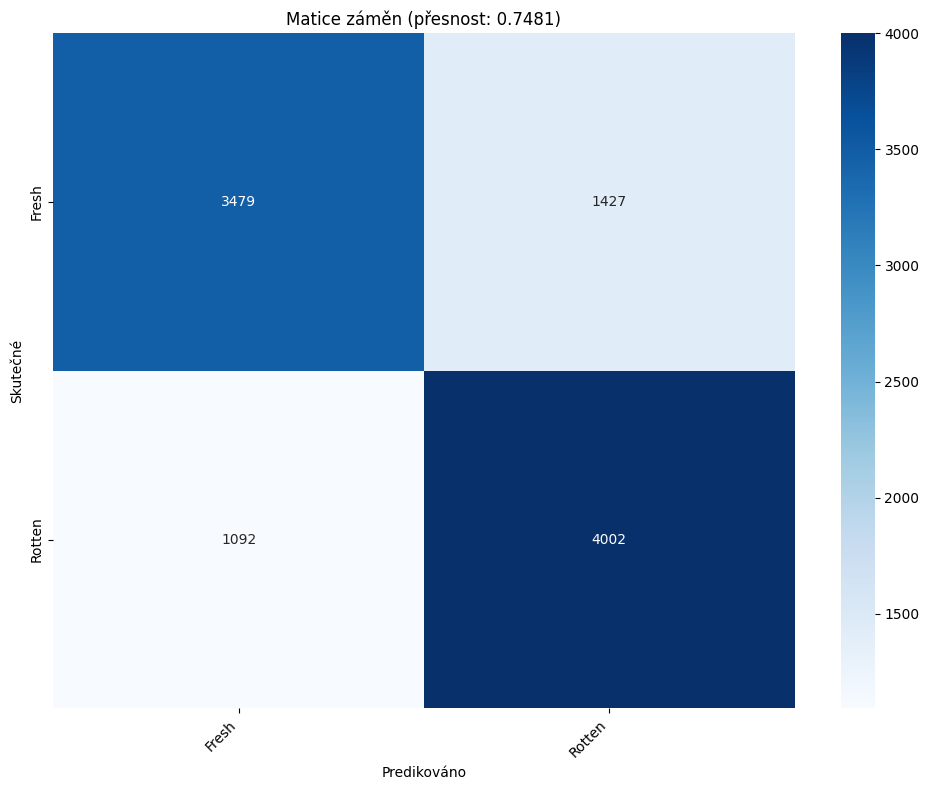

In [384]:
acc_7, report_7 = evaluate_model(model_7, X_test_pad, y_test)

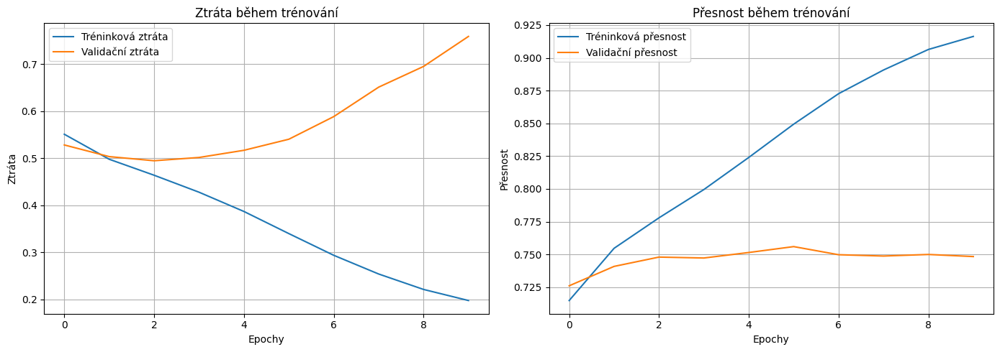

In [385]:
plot_training_history(history_7)

In [386]:
print(f"Přesnost modelu 3: {acc_3:.4f}")
print(f"Přesnost modelu 7: {acc_7:.4f}")

Přesnost modelu 3: 0.7431
Přesnost modelu 7: 0.7481


Paráda! Konečně jsme dosáhli vyšší přesnosti s modelem, který kombinuje všechny předchozí vrstvy a porazili jsme model 3. 

## Model 8 - Optuna

### Nalezení nejlepších hyperparametrů

In [ ]:
def create_model_8(trial):
    inputs, x = glove_in_emb_tokenized()
    
    # Tune LSTM units
    lstm_units = trial.suggest_int('lstm_units', 64, 256)
    x = Bidirectional(LSTM(lstm_units, return_sequences=True))(x)
    
    # Tune dropout rate after LSTM
    lstm_dropout = trial.suggest_float('lstm_dropout', 0.1, 0.5)
    x = Dropout(lstm_dropout)(x)

    # Attention mechanism
    attention = Dense(1, activation='tanh')(x)
    attention = Flatten()(attention)
    attention = Activation('softmax')(attention)
    attention = RepeatVector(lstm_units * 2)(attention)  # *2 for bidirectional
    attention = Permute([2, 1])(attention)
    x = Multiply()([x, attention])
    x = Lambda(lambda z: K.sum(z, axis=1), output_shape=(lstm_units * 2,))(x)

    # Tune dense layers
    dense1_units = trial.suggest_int('dense1_units', 64, 256)
    x = Dense(dense1_units, activation='relu')(x)
    
    dense1_dropout = trial.suggest_float('dense1_dropout', 0.2, 0.5)
    x = Dropout(dense1_dropout)(x)
    
    dense2_units = trial.suggest_int('dense2_units', 32, 128)
    x = Dense(dense2_units, activation='relu')(x)
    
    dense2_dropout = trial.suggest_float('dense2_dropout', 0.1, 0.4)
    x = Dropout(dense2_dropout)(x)

    # Tune learning rate
    learning_rate = trial.suggest_float('learning_rate', 1e-4, 1e-2, log=True)
    
    outputs = Dense(1, activation='sigmoid')(x)

    model = Model(inputs=inputs, outputs=outputs)
    model.compile(
        optimizer=Adam(learning_rate=learning_rate),
        loss='binary_crossentropy',
        metrics=['accuracy']
    )
    return model

In [168]:
def objective(trial):
    model = create_model_8(trial)
    
    early_stopping = EarlyStopping(
        monitor='val_loss',
        patience=3,
        restore_best_weights=True
    )
    
    history = model.fit(
        X_train_pad , y_train,
        validation_data=(X_valid_pad, y_val),
        epochs=EPOCHS,
        batch_size=trial.suggest_categorical('batch_size', [16, 32, 64]),
        callbacks=[early_stopping],
        verbose=1
    )
    
    val_accuracy = max(history.history['val_accuracy'])
    
    return val_accuracy

In [169]:
start_time = time.time()
n_trials = 20

optuna.logging.set_verbosity(verbosity=optuna.logging.WARNING)
study = optuna.create_study(direction='maximize', sampler=TPESampler(seed=SEED))

with tqdm(total=n_trials, desc="Optimalizace modelu") as pbar:
	for _ in range(n_trials):
		study.optimize(objective, n_trials=1)
		pbar.update(1)
		pbar.set_postfix({
			'Best Value': f"{study.best_trial.value:.4f}",
			'Best Params': study.best_trial.params
		})

end_time = time.time()
elapsed_time = end_time - start_time

print("\n" + "="*50)
print('Výsledky nejlepšího pokusu:')
print("="*50)
print(f'  Hodnota (přesnost validace): {study.best_trial.value:.4f}')
print('  Parametry: ')
for key, value in study.best_trial.params.items():
	print(f'    {key}: {value}')
print("="*50)
print(f"Optimalizace trvala {elapsed_time:.2f} sekund.")

Optimalizace modelu:   0%|          | 0/20 [00:00<?, ?it/s]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 197s 39ms/step - accuracy: 0.6813 - loss: 0.5957 - val_accuracy: 0.7190 - val_loss: 0.5390
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 189s 38ms/step - accuracy: 0.7289 - loss: 0.5326 - val_accuracy: 0.7285 - val_loss: 0.5249
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 190s 38ms/step - accuracy: 0.7476 - loss: 0.5101 - val_accuracy: 0.7381 - val_loss: 0.5148
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 189s 38ms/step - accuracy: 0.7625 - loss: 0.4893 - val_accuracy: 0.7479 - val_loss: 0.5043
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 189s 38ms/step - accuracy: 0.7736 - loss: 0.4726 - val_accuracy: 0.7397 - val_loss: 0.5159
Epoch 6/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 188s 38ms/step - accuracy: 0.7836 - loss: 0.4570 - val_accuracy: 0.7459 - val_loss: 0.5117
Epoch 7/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 189s 38ms/step - accuracy: 0.7942 - loss: 0.4411 - val_accuracy: 0.7513 - val_loss: 0.5117


Optimalizace modelu:   5%|▌         | 1/20 [22:22<7:05:16, 1342.97s/it, Best Value=0.7513, Best Params={'lstm_units': 136, 'lstm_dropout': 0.4802857225639665, 'dense1_units': 205, 'dense1_dropout': 0.379597545259111, 'dense2_units': 47, 'dense2_dropout': 0.1467983561008608, 'learning_rate': 0.00013066739238053285, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 192s 38ms/step - accuracy: 0.6907 - loss: 0.5756 - val_accuracy: 0.7283 - val_loss: 0.5281
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 189s 38ms/step - accuracy: 0.7509 - loss: 0.5029 - val_accuracy: 0.7466 - val_loss: 0.5049
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 190s 38ms/step - accuracy: 0.7726 - loss: 0.4731 - val_accuracy: 0.7483 - val_loss: 0.5034
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 192s 38ms/step - accuracy: 0.7890 - loss: 0.4468 - val_accuracy: 0.7534 - val_loss: 0.5072
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 192s 38ms/step - accuracy: 0.8029 - loss: 0.4231 - val_accuracy: 0.7528 - val_loss: 0.5149
Epoch 6/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 190s 38ms/step - accuracy: 0.8182 - loss: 0.3990 - val_accuracy: 0.7559 - val_loss: 0.5243


Optimalizace modelu:  10%|█         | 2/20 [41:37<6:09:38, 1232.15s/it, Best Value=0.7559, Best Params={'lstm_units': 67, 'lstm_dropout': 0.4879639408647978, 'dense1_units': 224, 'dense1_dropout': 0.26370173320348284, 'dense2_units': 49, 'dense2_dropout': 0.15502135295603015, 'learning_rate': 0.0004059611610484307, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - accuracy: 0.6772 - loss: 0.5984

2025-06-13 15:20:17.743140: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 106s 41ms/step - accuracy: 0.6772 - loss: 0.5984 - val_accuracy: 0.7177 - val_loss: 0.5484
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 104s 42ms/step - accuracy: 0.7320 - loss: 0.5306 - val_accuracy: 0.7316 - val_loss: 0.5208
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 103s 41ms/step - accuracy: 0.7519 - loss: 0.5054 - val_accuracy: 0.7396 - val_loss: 0.5124
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 104s 41ms/step - accuracy: 0.7675 - loss: 0.4807 - val_accuracy: 0.7538 - val_loss: 0.4987
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 103s 41ms/step - accuracy: 0.7843 - loss: 0.4586 - val_accuracy: 0.7596 - val_loss: 0.4918
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 103s 41ms/step - accuracy: 0.7998 - loss: 0.4359 - val_accuracy: 0.7628 - val_loss: 0.4894
Epoch 7/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 104s 41ms/step - accuracy: 0.8158 - loss: 0.4120 - val_accuracy: 0.7641 - val_loss: 0.4939
Epoch 8/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 109s 43ms/step - accuracy: 0.8296 - lo

Optimalizace modelu:  15%|█▌        | 3/20 [57:34<5:13:33, 1106.67s/it, Best Value=0.7641, Best Params={'lstm_units': 182, 'lstm_dropout': 0.15579754426081674, 'dense1_units': 120, 'dense1_dropout': 0.3099085529881075, 'dense2_units': 76, 'dense2_dropout': 0.33555278841790415, 'learning_rate': 0.00025081156860452336, 'batch_size': 32}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2499/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step - accuracy: 0.6684 - loss: 0.6014

2025-06-13 15:36:22.448760: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 113s 44ms/step - accuracy: 0.6684 - loss: 0.6013 - val_accuracy: 0.7222 - val_loss: 0.5353
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 104s 42ms/step - accuracy: 0.7456 - loss: 0.5152 - val_accuracy: 0.7346 - val_loss: 0.5175
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 104s 42ms/step - accuracy: 0.7640 - loss: 0.4865 - val_accuracy: 0.7433 - val_loss: 0.5080
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 104s 42ms/step - accuracy: 0.7818 - loss: 0.4601 - val_accuracy: 0.7535 - val_loss: 0.4916
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 104s 42ms/step - accuracy: 0.7985 - loss: 0.4319 - val_accuracy: 0.7643 - val_loss: 0.4966
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 104s 42ms/step - accuracy: 0.8196 - loss: 0.3975 - val_accuracy: 0.7582 - val_loss: 0.5275
Epoch 7/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 105s 42ms/step - accuracy: 0.8416 - loss: 0.3614 - val_accuracy: 0.7498 - val_loss: 0.5615


Optimalizace modelu:  20%|██        | 4/20 [1:10:04<4:17:32, 965.77s/it, Best Value=0.7643, Best Params={'lstm_units': 181, 'lstm_dropout': 0.16820964947491662, 'dense1_units': 76, 'dense1_dropout': 0.48466566117599996, 'dense2_units': 125, 'dense2_dropout': 0.3425192044349384, 'learning_rate': 0.0004066563313514797, 'batch_size': 32}] 

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - accuracy: 0.6786 - loss: 0.5961

2025-06-13 15:48:38.632897: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 100s 39ms/step - accuracy: 0.6786 - loss: 0.5961 - val_accuracy: 0.7290 - val_loss: 0.5321
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 94s 38ms/step - accuracy: 0.7427 - loss: 0.5207 - val_accuracy: 0.7383 - val_loss: 0.5158
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 94s 38ms/step - accuracy: 0.7619 - loss: 0.4918 - val_accuracy: 0.7472 - val_loss: 0.4995
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 95s 38ms/step - accuracy: 0.7786 - loss: 0.4681 - val_accuracy: 0.7547 - val_loss: 0.4896
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 95s 38ms/step - accuracy: 0.7934 - loss: 0.4452 - val_accuracy: 0.7582 - val_loss: 0.4871
Epoch 6/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 95s 38ms/step - accuracy: 0.8090 - loss: 0.4227 - val_accuracy: 0.7530 - val_loss: 0.4906
Epoch 7/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 98s 39ms/step - accuracy: 0.8219 - loss: 0.3998 - val_accuracy: 0.7468 - val_loss: 0.5032
Epoch 8/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 183s 55ms/step - accuracy: 0.8338 - loss: 0.

Optimalizace modelu:  25%|██▌       | 5/20 [1:24:28<3:52:17, 929.15s/it, Best Value=0.7643, Best Params={'lstm_units': 181, 'lstm_dropout': 0.16820964947491662, 'dense1_units': 76, 'dense1_dropout': 0.48466566117599996, 'dense2_units': 125, 'dense2_dropout': 0.3425192044349384, 'learning_rate': 0.0004066563313514797, 'batch_size': 32}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - accuracy: 0.6701 - loss: 0.6065

2025-06-13 16:02:58.676541: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 95s 73ms/step - accuracy: 0.6701 - loss: 0.6065 - val_accuracy: 0.7154 - val_loss: 0.5560
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 97s 77ms/step - accuracy: 0.7296 - loss: 0.5409 - val_accuracy: 0.7217 - val_loss: 0.5386
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 73s 58ms/step - accuracy: 0.7409 - loss: 0.5211 - val_accuracy: 0.7328 - val_loss: 0.5227
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 70s 56ms/step - accuracy: 0.7537 - loss: 0.5024 - val_accuracy: 0.7198 - val_loss: 0.5328
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 70s 56ms/step - accuracy: 0.7660 - loss: 0.4873 - val_accuracy: 0.7227 - val_loss: 0.5224
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 73s 58ms/step - accuracy: 0.7739 - loss: 0.4725 - val_accuracy: 0.7229 - val_loss: 0.5238
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 76s 61ms/step - accuracy: 0.7839 - loss: 0.4586 - val_accuracy: 0.7174 - val_loss: 0.5251
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 70s 56ms/step - accuracy: 0.7943 - loss: 0.44

Optimalizace modelu:  30%|███       | 6/20 [1:35:05<3:13:33, 829.55s/it, Best Value=0.7643, Best Params={'lstm_units': 181, 'lstm_dropout': 0.16820964947491662, 'dense1_units': 76, 'dense1_dropout': 0.48466566117599996, 'dense2_units': 125, 'dense2_dropout': 0.3425192044349384, 'learning_rate': 0.0004066563313514797, 'batch_size': 32}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - accuracy: 0.6754 - loss: 0.6014

2025-06-13 16:13:00.641238: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 59s 45ms/step - accuracy: 0.6754 - loss: 0.6014 - val_accuracy: 0.7202 - val_loss: 0.5453
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 58s 47ms/step - accuracy: 0.7326 - loss: 0.5340 - val_accuracy: 0.7358 - val_loss: 0.5272
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 55s 44ms/step - accuracy: 0.7488 - loss: 0.5105 - val_accuracy: 0.7424 - val_loss: 0.5151
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 58s 47ms/step - accuracy: 0.7632 - loss: 0.4904 - val_accuracy: 0.7449 - val_loss: 0.5085
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 56s 45ms/step - accuracy: 0.7746 - loss: 0.4746 - val_accuracy: 0.7524 - val_loss: 0.5008
Epoch 6/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 54s 43ms/step - accuracy: 0.7832 - loss: 0.4602 - val_accuracy: 0.7489 - val_loss: 0.5042
Epoch 7/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 53s 43ms/step - accuracy: 0.7920 - loss: 0.4468 - val_accuracy: 0.7385 - val_loss: 0.5147
Epoch 8/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 54s 43ms/step - accuracy: 0.8009 - loss: 0.43

Optimalizace modelu:  35%|███▌      | 7/20 [1:42:44<2:33:31, 708.60s/it, Best Value=0.7643, Best Params={'lstm_units': 181, 'lstm_dropout': 0.16820964947491662, 'dense1_units': 76, 'dense1_dropout': 0.48466566117599996, 'dense2_units': 125, 'dense2_dropout': 0.3425192044349384, 'learning_rate': 0.0004066563313514797, 'batch_size': 32}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step - accuracy: 0.6764 - loss: 0.5862

2025-06-13 16:21:28.935358: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 110s 43ms/step - accuracy: 0.6764 - loss: 0.5862 - val_accuracy: 0.7513 - val_loss: 0.4993
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 106s 42ms/step - accuracy: 0.7448 - loss: 0.5222 - val_accuracy: 0.7637 - val_loss: 0.4802
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 106s 42ms/step - accuracy: 0.7896 - loss: 0.4551 - val_accuracy: 0.7655 - val_loss: 0.4826
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 106s 42ms/step - accuracy: 0.8133 - loss: 0.4121 - val_accuracy: 0.7594 - val_loss: 0.4944
Epoch 5/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 106s 42ms/step - accuracy: 0.8402 - loss: 0.3613 - val_accuracy: 0.7566 - val_loss: 0.5151


Optimalizace modelu:  40%|████      | 8/20 [1:51:49<2:11:18, 656.53s/it, Best Value=0.7655, Best Params={'lstm_units': 213, 'lstm_dropout': 0.17948627261366898, 'dense1_units': 65, 'dense1_dropout': 0.44463842853645025, 'dense2_units': 100, 'dense2_dropout': 0.3187021504122962, 'learning_rate': 0.0034877126245459306, 'batch_size': 32}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
2499/2500 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step - accuracy: 0.6863 - loss: 0.5730

2025-06-13 16:30:32.116655: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


2500/2500 ━━━━━━━━━━━━━━━━━━━━ 109s 42ms/step - accuracy: 0.6863 - loss: 0.5729 - val_accuracy: 0.7534 - val_loss: 0.4943
Epoch 2/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 107s 43ms/step - accuracy: 0.7294 - loss: 0.5401 - val_accuracy: 0.7538 - val_loss: 0.4946
Epoch 3/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 109s 44ms/step - accuracy: 0.7738 - loss: 0.4755 - val_accuracy: 0.7575 - val_loss: 0.5090
Epoch 4/10
2500/2500 ━━━━━━━━━━━━━━━━━━━━ 110s 44ms/step - accuracy: 0.7996 - loss: 0.4331 - val_accuracy: 0.7583 - val_loss: 0.5281


Optimalizace modelu:  45%|████▌     | 9/20 [1:59:15<1:48:15, 590.54s/it, Best Value=0.7655, Best Params={'lstm_units': 213, 'lstm_dropout': 0.17948627261366898, 'dense1_units': 65, 'dense1_dropout': 0.44463842853645025, 'dense2_units': 100, 'dense2_dropout': 0.3187021504122962, 'learning_rate': 0.0034877126245459306, 'batch_size': 32}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 190s 37ms/step - accuracy: 0.6970 - loss: 0.5691 - val_accuracy: 0.7513 - val_loss: 0.5048
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 192s 38ms/step - accuracy: 0.7641 - loss: 0.4866 - val_accuracy: 0.7601 - val_loss: 0.4890
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 219s 44ms/step - accuracy: 0.7893 - loss: 0.4449 - val_accuracy: 0.7574 - val_loss: 0.5043
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 217s 43ms/step - accuracy: 0.8137 - loss: 0.4051 - val_accuracy: 0.7712 - val_loss: 0.4979
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 225s 45ms/step - accuracy: 0.8379 - loss: 0.3615 - val_accuracy: 0.7666 - val_loss: 0.5423


Optimalizace modelu:  50%|█████     | 10/20 [2:16:48<2:02:15, 733.51s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 220s 42ms/step - accuracy: 0.6938 - loss: 0.5666 - val_accuracy: 0.7532 - val_loss: 0.4960
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 185s 37ms/step - accuracy: 0.7665 - loss: 0.4817 - val_accuracy: 0.7518 - val_loss: 0.5023
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 185s 37ms/step - accuracy: 0.7942 - loss: 0.4376 - val_accuracy: 0.7686 - val_loss: 0.4978
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 184s 37ms/step - accuracy: 0.8211 - loss: 0.3894 - val_accuracy: 0.7666 - val_loss: 0.5138


Optimalizace modelu:  55%|█████▌    | 11/20 [2:29:55<1:52:27, 749.67s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 189s 37ms/step - accuracy: 0.6979 - loss: 0.5649 - val_accuracy: 0.7411 - val_loss: 0.5128
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 187s 37ms/step - accuracy: 0.7685 - loss: 0.4807 - val_accuracy: 0.7585 - val_loss: 0.5005
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 191s 38ms/step - accuracy: 0.7985 - loss: 0.4333 - val_accuracy: 0.7641 - val_loss: 0.5077
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 190s 38ms/step - accuracy: 0.8292 - loss: 0.3801 - val_accuracy: 0.7654 - val_loss: 0.5513
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 191s 38ms/step - accuracy: 0.8568 - loss: 0.3290 - val_accuracy: 0.7599 - val_loss: 0.5979


Optimalizace modelu:  60%|██████    | 12/20 [2:45:55<1:48:30, 813.78s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 185s 36ms/step - accuracy: 0.5012 - loss: 0.6972 - val_accuracy: 0.4975 - val_loss: 0.6943
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 185s 37ms/step - accuracy: 0.4981 - loss: 0.6935 - val_accuracy: 0.4975 - val_loss: 0.6943
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 184s 37ms/step - accuracy: 0.4981 - loss: 0.6935 - val_accuracy: 0.4975 - val_loss: 0.6943
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 184s 37ms/step - accuracy: 0.4981 - loss: 0.6935 - val_accuracy: 0.4975 - val_loss: 0.6943
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 185s 37ms/step - accuracy: 0.4981 - loss: 0.6935 - val_accuracy: 0.4975 - val_loss: 0.6943


Optimalizace modelu:  65%|██████▌   | 13/20 [3:01:29<1:39:10, 850.13s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 190s 37ms/step - accuracy: 0.6979 - loss: 0.5624 - val_accuracy: 0.7505 - val_loss: 0.4994
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 187s 37ms/step - accuracy: 0.7684 - loss: 0.4806 - val_accuracy: 0.7557 - val_loss: 0.4880
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 202s 40ms/step - accuracy: 0.7925 - loss: 0.4363 - val_accuracy: 0.7605 - val_loss: 0.4976
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 232s 46ms/step - accuracy: 0.8191 - loss: 0.3927 - val_accuracy: 0.7665 - val_loss: 0.5244
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 192s 38ms/step - accuracy: 0.8458 - loss: 0.3454 - val_accuracy: 0.7633 - val_loss: 0.5504


Optimalizace modelu:  70%|███████   | 14/20 [3:18:25<1:30:00, 900.16s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 184s 36ms/step - accuracy: 0.7032 - loss: 0.5619 - val_accuracy: 0.7463 - val_loss: 0.5009
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 177s 35ms/step - accuracy: 0.7657 - loss: 0.4850 - val_accuracy: 0.7642 - val_loss: 0.4849
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 185s 37ms/step - accuracy: 0.7922 - loss: 0.4426 - val_accuracy: 0.7625 - val_loss: 0.4979
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 194s 39ms/step - accuracy: 0.8160 - loss: 0.4025 - val_accuracy: 0.7672 - val_loss: 0.5040
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 199s 40ms/step - accuracy: 0.8407 - loss: 0.3613 - val_accuracy: 0.7667 - val_loss: 0.5162


Optimalizace modelu:  75%|███████▌  | 15/20 [3:34:16<1:16:18, 915.73s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 211s 42ms/step - accuracy: 0.7010 - loss: 0.5607 - val_accuracy: 0.7583 - val_loss: 0.4903
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 205s 41ms/step - accuracy: 0.7741 - loss: 0.4733 - val_accuracy: 0.7640 - val_loss: 0.4907
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 204s 41ms/step - accuracy: 0.8043 - loss: 0.4248 - val_accuracy: 0.7667 - val_loss: 0.5043
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 189s 38ms/step - accuracy: 0.8332 - loss: 0.3740 - val_accuracy: 0.7662 - val_loss: 0.5517


Optimalizace modelu:  80%|████████  | 16/20 [3:47:58<59:09, 887.32s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]  

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 191s 38ms/step - accuracy: 0.7028 - loss: 0.5657 - val_accuracy: 0.7458 - val_loss: 0.5066
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 188s 38ms/step - accuracy: 0.7622 - loss: 0.4882 - val_accuracy: 0.7625 - val_loss: 0.4922
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 188s 38ms/step - accuracy: 0.7923 - loss: 0.4437 - val_accuracy: 0.7590 - val_loss: 0.5072
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 188s 38ms/step - accuracy: 0.8219 - loss: 0.3927 - val_accuracy: 0.7597 - val_loss: 0.5588
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 188s 38ms/step - accuracy: 0.8539 - loss: 0.3361 - val_accuracy: 0.7614 - val_loss: 0.6384


Optimalizace modelu:  85%|████████▌ | 17/20 [4:03:52<45:22, 907.40s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
1249/1250 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step - accuracy: 0.6652 - loss: 0.5946

2025-06-13 18:41:43.102494: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_15}}


1250/1250 ━━━━━━━━━━━━━━━━━━━━ 54s 41ms/step - accuracy: 0.6653 - loss: 0.5945 - val_accuracy: 0.7421 - val_loss: 0.5181
Epoch 2/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 51s 40ms/step - accuracy: 0.7662 - loss: 0.4860 - val_accuracy: 0.7576 - val_loss: 0.4941
Epoch 3/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 51s 41ms/step - accuracy: 0.7918 - loss: 0.4443 - val_accuracy: 0.7581 - val_loss: 0.4982
Epoch 4/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 51s 41ms/step - accuracy: 0.8164 - loss: 0.4058 - val_accuracy: 0.7549 - val_loss: 0.5029
Epoch 5/10
1250/1250 ━━━━━━━━━━━━━━━━━━━━ 51s 41ms/step - accuracy: 0.8325 - loss: 0.3733 - val_accuracy: 0.7516 - val_loss: 0.5230


Optimalizace modelu:  90%|█████████ | 18/20 [4:08:21<23:51, 715.50s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 188s 37ms/step - accuracy: 0.6961 - loss: 0.5677 - val_accuracy: 0.7441 - val_loss: 0.5091
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 183s 37ms/step - accuracy: 0.7585 - loss: 0.4913 - val_accuracy: 0.7630 - val_loss: 0.4898
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 182s 36ms/step - accuracy: 0.7818 - loss: 0.4549 - val_accuracy: 0.7686 - val_loss: 0.4923
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 181s 36ms/step - accuracy: 0.8113 - loss: 0.4097 - val_accuracy: 0.7619 - val_loss: 0.5264
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 182s 36ms/step - accuracy: 0.8350 - loss: 0.3675 - val_accuracy: 0.7639 - val_loss: 0.5428


Optimalizace modelu:  95%|█████████▌| 19/20 [4:23:49<12:59, 779.39s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]

GloVe vektory: 9686 nalezeno a 313 chybí
Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 182s 36ms/step - accuracy: 0.7029 - loss: 0.5586 - val_accuracy: 0.7528 - val_loss: 0.4961
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 180s 36ms/step - accuracy: 0.7722 - loss: 0.4752 - val_accuracy: 0.7631 - val_loss: 0.4897
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 179s 36ms/step - accuracy: 0.8021 - loss: 0.4268 - val_accuracy: 0.7635 - val_loss: 0.4911
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 179s 36ms/step - accuracy: 0.8292 - loss: 0.3816 - val_accuracy: 0.7650 - val_loss: 0.5259
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 179s 36ms/step - accuracy: 0.8510 - loss: 0.3362 - val_accuracy: 0.7632 - val_loss: 0.6101


Optimalizace modelu: 100%|██████████| 20/20 [4:38:59<00:00, 836.98s/it, Best Value=0.7712, Best Params={'lstm_units': 87, 'lstm_dropout': 0.38529791488919807, 'dense1_units': 210, 'dense1_dropout': 0.36838315927084886, 'dense2_units': 106, 'dense2_dropout': 0.24813867890931726, 'learning_rate': 0.0011103647313054626, 'batch_size': 16}]


Výsledky nejlepšího pokusu:
  Hodnota (přesnost validace): 0.7712
  Parametry: 
    lstm_units: 87
    lstm_dropout: 0.38529791488919807
    dense1_units: 210
    dense1_dropout: 0.36838315927084886
    dense2_units: 106
    dense2_dropout: 0.24813867890931726
    learning_rate: 0.0011103647313054626
    batch_size: 16
Optimalizace trvala 16739.51 sekund.


### Samotný trénink "nejlepšího" modelu

In [396]:
def create_model_8():
	params = study.best_trial.params
	
	print(f"\nVytváříme model s nejlepšími parametry...")
	print(f"  LSTM jednotky: {params['lstm_units']}")
	print(f"  LSTM dropout: {params['lstm_dropout']:.2f}")
	print(f"  Husté vrstvy: {params['dense1_units']} -> {params['dense2_units']}")
	print(f"  Dropouty: {params['dense1_dropout']:.2f} -> {params['dense2_dropout']:.2f}")
	print(f"  Rychlost učení: {params['learning_rate']:.6f}")
	print(f"  Velikost dávky: {params['batch_size']}")
	
	inputs, x = glove_in_emb_tokenized()
	
	x = Bidirectional(LSTM(params['lstm_units'], return_sequences=True))(x)
	x = Dropout(params['lstm_dropout'])(x)
	
	attention = Dense(1, activation='tanh')(x)
	attention = Flatten()(attention)
	attention = Activation('softmax')(attention)
	attention = RepeatVector(params['lstm_units'] * 2)(attention)
	attention = Permute([2, 1])(attention)
	x = Multiply()([x, attention])
	x = Lambda(lambda z: K.sum(z, axis=1))(x)
	
	x = Dense(params['dense1_units'], activation='relu')(x)
	x = Dropout(params['dense1_dropout'])(x)
	x = Dense(params['dense2_units'], activation='relu')(x)
	x = Dropout(params['dense2_dropout'])(x)
	
	outputs = Dense(1, activation='sigmoid')(x)
	
	model = Model(inputs=inputs, outputs=outputs)
	model.compile(
		optimizer=Adam(learning_rate=params['learning_rate']),
		loss='binary_crossentropy',
		metrics=['accuracy']
	)
	return model

In [402]:
model_8 = create_model_8()
model_8.summary()


Vytváříme model s nejlepšími parametry...
  LSTM jednotky: 87
  LSTM dropout: 0.39
  Husté vrstvy: 210 -> 106
  Dropouty: 0.37 -> 0.25
  Rychlost učení: 0.001110
  Velikost dávky: 16
GloVe vektory: 9686 nalezeno a 313 chybí


Model: "functional_46"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_50      │ (None, 128)       │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ embedding_50        │ (None, 128, 200)  │  2,000,000 │ input_layer_50[0… │
│ (Embedding)         │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ bidirectional_41    │ (None, 128, 174)  │    200,448 │ embedding_50[0][… │
│ (Bidirectional)     │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_152         │ (None, 128, 174)  │          0 │ bidirectional_41… │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_192 (Dense)   │ (None, 128, 1)    │        175 │ dropout_152[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ flatten_42          │ (None, 128)       │          0 │ dense_192[0][0]   │
│ (Flatten)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_42       │ (None, 128)       │          0 │ flatten_42[0][0]  │
│ (Activation)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ repeat_vector_42    │ (None, 174, 128)  │          0 │ activation_42[0]… │
│ (RepeatVector)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ permute_42          │ (None, 128, 174)  │          0 │ repeat_vector_42… │
│ (Permute)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ multiply_42         │ (None, 128, 174)  │          0 │ dropout_152[0][0… │
│ (Multiply)          │                   │            │ permute_42[0][0]  │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ lambda_39 (Lambda)  │ (None, 174)       │          0 │ multiply_42[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_193 (Dense)   │ (None, 210)       │     36,750 │ lambda_39[0][0]   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_153         │ (None, 210)       │          0 │ dense_193[0][0]   │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_194 (Dense)   │ (None, 106)       │     22,366 │ dropout_153[0][0] │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_154         │ (None, 106)       │          0 │ dense_194[0][0]   │
│ (Dropout)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dense_195 (Dense)   │ (None, 1)         │        107 │ dropout_154[0][0] │
└─────────────────────┴───────────────────┴────────────┴───────────────────┘

 Total params: 2,259,846 (8.62 MB)

 Trainable params: 259,846 (1015.02 KB)

 Non-trainable params: 2,000,000 (7.63 MB)

In [403]:
start_time = time.time()
history_8 = model_8.fit(
	X_train_pad,
	y_train,
	validation_data=(X_valid_pad, y_val),
	epochs=EPOCHS,
	batch_size=study.best_trial.params['batch_size'],
	callbacks=[
		ModelCheckpoint(
			filepath='models/third/model_8.keras', 
			monitor='val_accuracy',
			save_best_only=True,
		),
		tensorboard_callback
	],
)
train_time_8 = time.time() - start_time
print(f"Trénink modelu 8 trval {train_time_8:.2f} sekund.")

Epoch 1/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 231s 45ms/step - accuracy: 0.7033 - loss: 0.5615 - val_accuracy: 0.7363 - val_loss: 0.5199
Epoch 2/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 238s 47ms/step - accuracy: 0.7622 - loss: 0.4848 - val_accuracy: 0.7651 - val_loss: 0.4887
Epoch 3/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 187s 37ms/step - accuracy: 0.7903 - loss: 0.4403 - val_accuracy: 0.7683 - val_loss: 0.5014
Epoch 4/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 193s 39ms/step - accuracy: 0.8181 - loss: 0.3983 - val_accuracy: 0.7669 - val_loss: 0.5438
Epoch 5/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 195s 39ms/step - accuracy: 0.8425 - loss: 0.3518 - val_accuracy: 0.7696 - val_loss: 0.5878
Epoch 6/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 194s 39ms/step - accuracy: 0.8647 - loss: 0.3090 - val_accuracy: 0.7576 - val_loss: 0.6892
Epoch 7/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 192s 38ms/step - accuracy: 0.8813 - loss: 0.2688 - val_accuracy: 0.7546 - val_loss: 0.7561
Epoch 8/10
5000/5000 ━━━━━━━━━━━━━━━━━━━━ 193s 38ms/step - accuracy: 

2025-06-14 00:44:10.286214: E tensorflow/core/framework/node_def_util.cc:680] NodeDef mentions attribute use_unbounded_threadpool which is not in the op definition: Op<name=MapDataset; signature=input_dataset:variant, other_arguments: -> handle:variant; attr=f:func; attr=Targuments:list(type),min=0; attr=output_types:list(type),min=1; attr=output_shapes:list(shape),min=1; attr=use_inter_op_parallelism:bool,default=true; attr=preserve_cardinality:bool,default=false; attr=force_synchronous:bool,default=false; attr=metadata:string,default=""> This may be expected if your graph generating binary is newer  than this binary. Unknown attributes will be ignored. NodeDef: {{node ParallelMapDatasetV2/_14}}


313/313 ━━━━━━━━━━━━━━━━━━━━ 5s 14ms/step
Celková přesnost: 0.7483

Klasifikační zpráva:
              precision    recall  f1-score   support

       Fresh       0.76      0.71      0.73      4906
      Rotten       0.74      0.79      0.76      5094

    accuracy                           0.75     10000
   macro avg       0.75      0.75      0.75     10000
weighted avg       0.75      0.75      0.75     10000



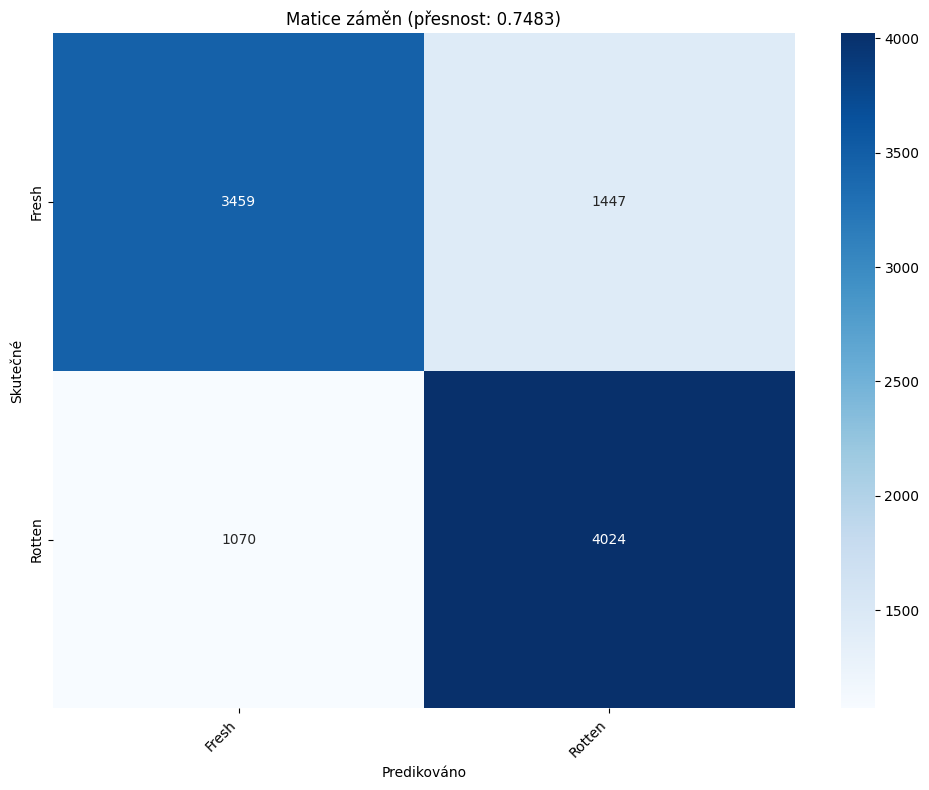

In [404]:
acc_8, report_8 = evaluate_model(model_8, X_test_pad, y_test)

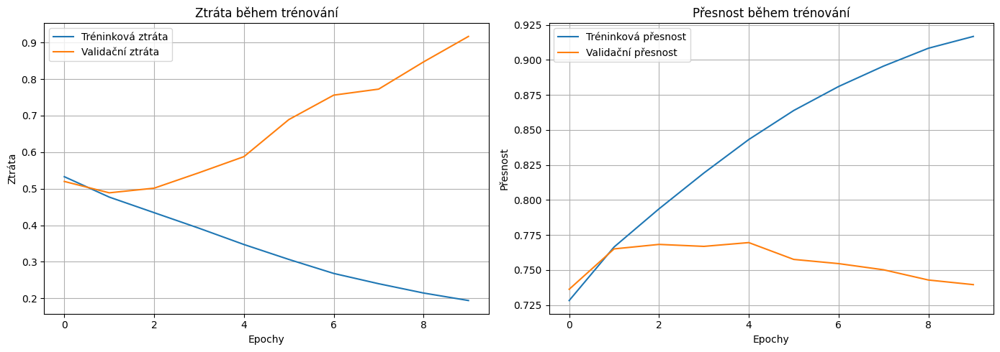

In [405]:
plot_training_history(history_8)

In [406]:
print(f"Přesnost modelu 7: {acc_7:.4f}")
print(f"Přesnost modelu 8: {acc_8:.4f}")

Přesnost modelu 7: 0.7481
Přesnost modelu 8: 0.7483


### Optuna vizualizace

In [177]:
fig = plot_optimization_history(study)
fig.update_layout(title="Historie optimalizace")
fig.show()

In [178]:
fig = plot_parallel_coordinate(study)
fig.update_layout(title="Paralelní souřadnice")
fig.show()

In [179]:
fig = plot_param_importances(study)
fig.update_layout(title="Důležitost parametrů")
fig.show()

In [180]:
fig = plot_contour(study)
fig.update_layout(title="Obrysový graf")
fig.show()

In [181]:
fig = plot_slice(study)
fig.update_layout(title="Graf řezu")
fig.show()

In [182]:
fig = plot_edf(study)
fig.update_layout(title="Empirická distribuční funkce")
fig.show()

In [186]:
fig = plot_timeline(study)
fig.update_layout(title="Timeline")
fig.show()

In [187]:
fig = plot_rank(study)
fig.update_layout(title="Rank")
fig.show()

## Model 9 - DisilBert base fine tuned SST 2 English

In [311]:
BATCH_SIZE = 16 # změněno z 64 na 16 pro kompatibilitu s GPU
EPOCHS = 1 		# změněno z 10 na 1 pro rychlejší trénink, jedna epocha by měla stačit pro rychlé testování

In [312]:
model_name = "distilbert-base-uncased-finetuned-sst-2-english"
tokenizer = DistilBertTokenizer.from_pretrained(model_name)
distilbert_model = TFDistilBertForSequenceClassification.from_pretrained(model_name, num_labels=2)

All PyTorch model weights were used when initializing TFDistilBertForSequenceClassification.

All the weights of TFDistilBertForSequenceClassification were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFDistilBertForSequenceClassification for predictions without further training.


In [313]:
def tokenize_data(texts, labels, tokenizer, max_length):
    encodings = tokenizer(
        list(texts),
        truncation=True,
        padding='max_length',
        max_length=max_length,
        return_tensors='tf'
    )
    
    input_dict = {
        'input_ids': encodings['input_ids'],
        'attention_mask': encodings['attention_mask'],
    }
    
    if 'token_type_ids' in encodings:
        input_dict['token_type_ids'] = encodings['token_type_ids']
    
    dataset = tf.data.Dataset.from_tensor_slices((
        input_dict,
        tf.one_hot(labels.astype('int32'), depth=2)
    ))
    
    return dataset

In [314]:
train_dataset = tokenize_data(X_train, y_train, tokenizer, SEQ_LENGTH).batch(BATCH_SIZE)
val_dataset = tokenize_data(X_val, y_val, tokenizer, SEQ_LENGTH).batch(BATCH_SIZE)
test_dataset = tokenize_data(X_test, y_test, tokenizer, SEQ_LENGTH).batch(BATCH_SIZE)

In [315]:
optimizer, _ = create_optimizer(
    init_lr=2e-5,
    num_train_steps=len(train_dataset) * EPOCHS,
    num_warmup_steps=int(0.1 * len(train_dataset) * EPOCHS)
)

distilbert_model.compile(
    optimizer=optimizer,
	loss='binary_crossentropy',
    metrics=['accuracy']
)

In [316]:
start_time = time.time()
history_9 = distilbert_model.fit(
	train_dataset,
	validation_data=val_dataset,
	epochs=EPOCHS
)
train_time_9 = time.time() - start_time
print(f"Trénink modelu DisilBert base fine tuned SST 2 English trval {train_time_9:.2f} sekund.")

5000/5000 [==============================] - 1467s 287ms/step - loss: 0.9101 - accuracy: 0.7478 - val_loss: 0.4916 - val_accuracy: 0.7688
Trénink modelu  DisilBert base fine tuned SST 2 English trval 1466.79 sekund.


625/625 [==============================] - 51s 82ms/step
Bert Tiny a jeho přesnost: 0.7675

Klasifikační zpráva pro Bert Tiny:
              precision    recall  f1-score   support

       Fresh       0.76      0.78      0.77      4906
      Rotten       0.78      0.76      0.77      5094

    accuracy                           0.77     10000
   macro avg       0.77      0.77      0.77     10000
weighted avg       0.77      0.77      0.77     10000



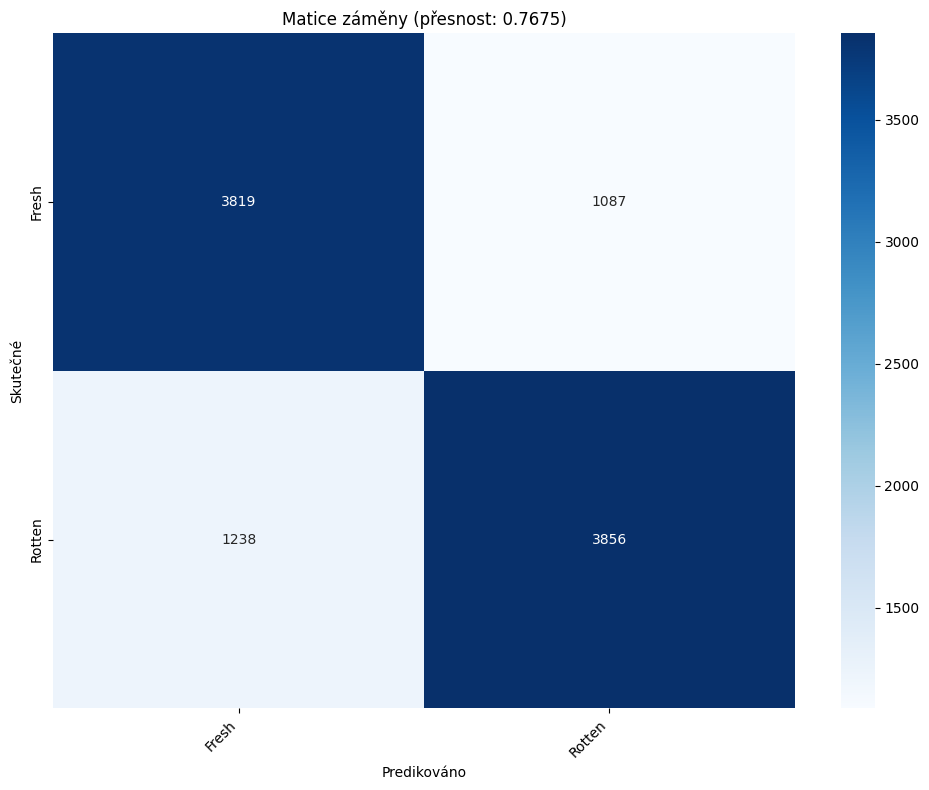

In [319]:
predictions = distilbert_model.predict(test_dataset)
y_pred = np.argmax(predictions.logits, axis=1)
y_true = np.argmax(tf.concat([y for _, y in test_dataset], axis=0).numpy(), axis=1)

acc_9 = accuracy_score(y_true, y_pred)
report_9 = classification_report(y_true, y_pred, target_names=class_names)

print(f"Bert Tiny a jeho přesnost: {acc_9:.4f}")
print("\nKlasifikační zpráva pro Bert Tiny:")
print(report_9)

cm = confusion_matrix(y_true, y_pred)
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
           xticklabels=class_names,
           yticklabels=class_names)
plt.xlabel('Predikováno')
plt.ylabel('Skutečné')
plt.title(f"Matice záměny (přesnost: {acc_9:.4f})")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [321]:
print(f"Předešlý nejlepší model (Model 8): {acc_8:.4f}")
print(f"DisilBert base fine tuned SST 2 English (Model 9): {acc_9:.4f}")

Předešlý nejlepší model (Model 8): 0.7483
DisilBert base fine tuned SST 2 English (Model 9): 0.7675


# Deployment-ready pipeline

In [318]:
BATCH_SIZE = 64
EPOCHS = 10

In [415]:
class ReviewSentimentPipeline:
	def __init__(self, model_path, tokenizer_path, seq_length=128, custom_objects=None):
		"""
		Inicializace pipeline pro analýzu sentimentu.

		Args:
			model_path (str): Cesta k uloženému Keras modelu
			tokenizer_path (str): Cesta k uloženému tokenizeru
			seq_length (int): Maximální délka sekvence pro padding
		"""
		# Načtení modelu
		self.model = load_model(model_path, custom_objects=custom_objects)
		
		# Načtení tokenizeru
		with open(tokenizer_path, 'rb') as handle:
			self.tokenizer = pickle.load(handle)
		
		# Inicializace nástrojů pro předzpracování
		self.seq_length = seq_length
		self.lemmatizer = WordNetLemmatizer()
		
		# Stažení potřebných dat NLTK, pokud nejsou dostupná
		try:
			nltk.data.find('corpora/stopwords')
			nltk.data.find('corpora/wordnet')
		except LookupError:
			nltk.download('stopwords', quiet=True)
			nltk.download('wordnet', quiet=True)
		
		self.stop_words = set(stopwords.words('english'))
	
	def _remove_stop_words(self, text):
		"""Odstranění stop slov z textu."""
		if not text:
			return ""
		words = text.split()
		filtered_words = [word for word in words if word.lower() not in self.stop_words]
		return ' '.join(filtered_words)
	
	def _lemmatize_text(self, text):
		"""Lemmatizace každého slova v textu."""
		return ' '.join([self.lemmatizer.lemmatize(word) for word in text.split()])
	
	def _clean_text(self, text):
		"""Vyčištění textu odstraněním speciálních znaků a převodem na malá písmena."""
		text = re.sub(r'[^a-zA-Z\s]', '', text)
		text = text.lower()
		text = text.strip()
		return text
	
	def _preprocess_text(self, text):
		"""Aplikace všech kroků předzpracování na text."""
		text = self._remove_stop_words(text)
		text = self._lemmatize_text(text)
		text = self._clean_text(text)
		return text
	
	def predict(self, texts, raw_text=True, return_probability=False):
		"""
		Predikce sentimentu z textu/textů.

		Args:
			texts (str nebo list): Jeden text recenze nebo seznam textů recenzí
			raw_text (bool): Pokud True, aplikuje předzpracování na text. Pokud False, předpokládá, že text je již předzpracovaný
			return_probability (bool): Pokud True, vrátí pravděpodobnosti. Pokud False, vrátí binární predikce a štítky tříd
			
		Returns:
			Pokud return_probability je False:
				Pro jeden vstup: tuple (predikce, štítek), kde predikce je 0 nebo 1 a štítek je 'Rotten' nebo 'Fresh'
				Pro více vstupů: seznam takových tuple
			Pokud return_probability je True:
				Pro jeden vstup: pravděpodobnost, že je 'Fresh' (0.0 až 1.0)
				Pro více vstupů: seznam takových pravděpodobností
		"""
		# Zpracování jednoho textu nebo seznamu textů
		single_input = isinstance(texts, str)
		if single_input:
			texts = [texts]
		
		# Předzpracování textů, pokud je potřeba
		if raw_text:
			processed_texts = [self._preprocess_text(text) for text in texts]
		else:
			processed_texts = texts
		
		# Tokenizace a padding sekvencí
		sequences = self.tokenizer.texts_to_sequences(processed_texts)
		padded_sequences = pad_sequences(sequences, maxlen=self.seq_length, padding='post')
		
		# Predikce
		predictions = self.model.predict(padded_sequences)
		
		if return_probability:
			results = predictions.flatten().tolist()
		else:
			binary_preds = (predictions > 0.5).astype(int).flatten()
			labels = ['Rotten' if pred == 0 else 'Fresh' for pred in binary_preds]
			results = list(zip(binary_preds.tolist(), labels))
		
		# Vrácení jednoho výsledku, pokud byl vstup jeden text
		if single_input:
			return results[0]
		return results
	
	def batch_predict(self, texts, batch_size=32, raw_text=True):
		"""
		Predikce sentimentu z textů v dávkách pro lepší správu paměti.

		Args:
			texts (list): Seznam textů recenzí
			batch_size (int): Počet textů ke zpracování v každé dávce
			raw_text (bool): Pokud True, aplikuje předzpracování na text
			
		Returns:
			Seznam tuple (predikce, štítek)
		"""
		results = []
		
		# Zpracování v dávkách
		for i in range(0, len(texts), batch_size):
			batch_texts = texts[i:i + batch_size]
			batch_results = self.predict(batch_texts, raw_text=raw_text, return_probability=False)
			results.extend(batch_results)
			
		return results

	@staticmethod
	def save_tokenizer(tokenizer, tokenizer_path):
		"""
		Uložení tokenizeru na disk.

		Args:
			tokenizer: Objekt tokenizeru
			tokenizer_path (str): Cesta, kam bude tokenizer uložen
		"""
		with open(tokenizer_path, 'wb') as handle:
			pickle.dump(tokenizer, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [419]:
original_model = models.load_model('models/third/model_8.keras')

NameError: name 'models' is not defined

In [414]:
# Save your trained tokenizer 
ReviewSentimentPipeline.save_tokenizer(tokenizer, 'models/third/tokenizer.pickle')

# Initialize the pipeline
# Define any custom objects used in your model
def custom_lambda_function(inputs):
    # Your Lambda function logic here
    return inputs  # Replace with actual implementation

custom_objects = {
    'Lambda': lambda x: Lambda(
        custom_lambda_function, 
        # output_shape=(None, your_output_dimension)
		output_shape=(None, 256)  # Adjust based on your model's output shape
    )
}

pipeline = ReviewSentimentPipeline(
    model_path="models/third/model_8.keras",
    tokenizer_path="models/third/tokenizer.pickle",
    custom_objects=custom_objects
)

NotImplementedError: Exception encountered when calling Lambda.call().

[1mWe could not automatically infer the shape of the Lambda's output. Please specify the `output_shape` argument for this Lambda layer.[0m

Arguments received by Lambda.call():
  • args=('<KerasTensor shape=(None, 128, 174), dtype=float32, sparse=False, ragged=False, name=keras_tensor_1212>',)
  • kwargs={'mask': 'None'}

In [ ]:
# Single prediction example
review = "This movie was absolutely fantastic! The plot and acting were amazing."
prediction, label = pipeline.predict(review)
print(f"Prediction: {prediction}, Label: {label}")

In [ ]:

# Batch prediction example
reviews = [
    "A terrible waste of time and money.",
    "One of the best films I've seen this year.",
    "Not great, not terrible, just average."
]
results = pipeline.predict(reviews)
for i, (pred, label) in enumerate(results):
    print(f"Review {i+1}: Prediction = {pred}, Label = {label}")

# Závěr

## Model 1 vs 2 - souboj embeddingů

## Model 3 a 4 - více vrstev 

## Model 5 a 6 - více dvousměrných vrstev a Attention vrstva

## Model 7 a 8 - All in One a Optuna - souboj nejlepších 

## Model 9 - DisilBert base fine tuned SST 2 English - ten nejlepší